In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

In [2]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

# functions 

In [4]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic


In [5]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T
similarity_vactor = lambda data, v : (v/(v.norm(dim = 1, keepdim=True)+1e-6) @(data/(data.norm(dim = 1, keepdim=True) +1e-6 ) ).T).flatten()
similarity_matrix_2mats = lambda data1, data2 : data1/data1.norm(dim = 1, keepdim=True) @(data2/data2.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


# Load denoisers 

In [7]:
denoisers = {}

root_path = '../denoisers/'

paths = { 
  
         'mixture-color-deep-no-skip':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_64x64/',

    
        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]
    
    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None
    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
     

loading group  mixture-color-deep-no-skip
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 1024
num_epochs 1500
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 1232457
imagenet_subset_ids None
data_name imagenet
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/21_hierarchical_conditional_prior/denoisers/UNet_flex/imagenet/0to255_RF_84x84_set_size_1232457_color_no_skip_deep_dec_64x64
optional_dir_label color_no_skip_deep_dec
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 512]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [6, 6, 6]
NormType LayerNorm
inter_skip True
dilations None
data_path /mnt/home/zkadkhodaie/ceph/datasets/imagenet
******************************************************
number of parameters is  13125187
train mode: Fa

In [8]:
denoisers.keys()

dict_keys(['mixture-color-deep-no-skip'])

In [9]:
layers = {}
for group in groups:
    layers[group] = []
    for i in range(len(denoisers[group].encoder)):
        layers[group].append(denoisers[group].encoder[str(i) ][0].weight.shape[0])
    
    layers[group].append(denoisers[group].mid[0].weight.shape[0])
    
    for i in range(len(denoisers[group].decoder)-1 , 0, -1):
        layers[group].append(denoisers[group].decoder[str(i) ][0].weight.shape[0])


layers

{'mixture-color-deep-no-skip': [64, 128, 256, 512, 256, 128]}

In [10]:
block_names = {}
for group in groups: 
    block_names[group] = []
    for l in range(int(len(layers[group])/2)): 
        block_names[group].append('enc' + str(l))
    block_names[group].append('mid'  )        
    for l in range(int(len(layers[group])/2)-1, 0,-1):
        block_names[group].append('dec' + str(l) )
block_names   

{'mixture-color-deep-no-skip': ['enc0', 'enc1', 'enc2', 'mid', 'dec2', 'dec1']}

# Load datasets 

In [11]:
time0 = time.time()
test_sets = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/imagenet/test_64x64_color_list.pt', weights_only=True) 
print(f"loading time: {time.time() - time0} seconds ")

loading time: 1.357743501663208 seconds 


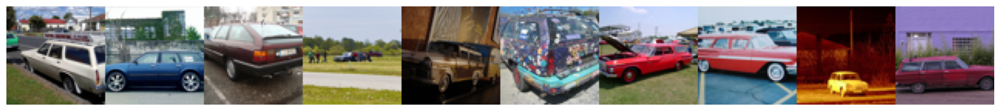

In [12]:
show_im_grid(test_sets[0][0:10] )


In [13]:
print('number of images in each class:', test_sets[0].shape)
K = test_sets[0].shape[2]
n_channels = test_sets[0].shape[1]
print(len(test_sets))

number of images in each class: torch.Size([49, 3, 64, 64])
999


tensor(0.4428)


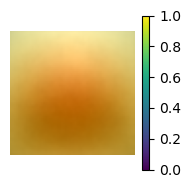

In [14]:
dist_mean = torch.concatenate(test_sets).mean(dim = (0))
plot_single_im(dist_mean, colorbar=True)
print(dist_mean.mean())

In [15]:
dist_mean.mean(dim = (1,2), keepdim = True)

tensor([[[0.4773]],

        [[0.4508]],

        [[0.4001]]])

In [16]:
test_sets_cat = torch.concatenate(test_sets)
test_sets_cat.shape

torch.Size([49051, 3, 64, 64])

120


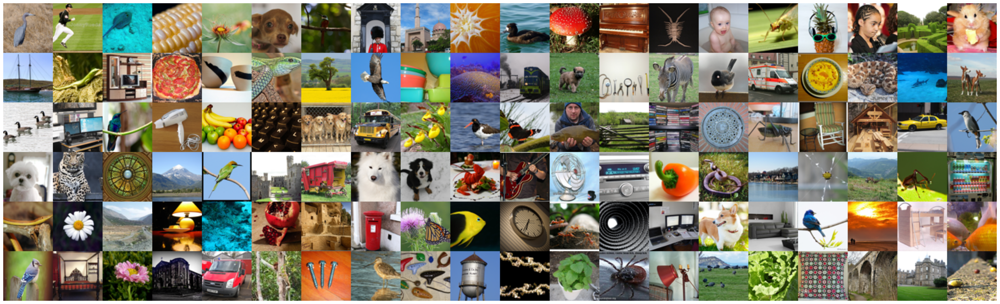

In [13]:
my_ids = [5, 31, 40, 46, 53, 58, 59,50+17, 50+45,104, 105, 117, 118, 124, 130,139 ,142, 150, 169, 179, 183, 186, 190,202, 209, 214, 229, 237, 260, 261, 275, 277, 288,291 , 307, 310, 316,336, 343,348,350,357,362,376,394,396, 
         408, 419, 440, 443, 459, 461, 486, 488,500, 524,525, 536, 546,570,572, 574, 576, 582,597, 603, 606,609, 615,622,636,651,660, 663,679,686, 692, 705,709,710,713,716,729, 746,747,752,761,763, 786,790,793,796, 
         802, 844, 846,851, 853,864,870,878,887,889, 891,  907, 909, 910, 919, 920, 921,930, 937,954, 956, 957,960, 968, 980, 992, 993,  995 ]

my_ims = torch.cat([test_sets[i][0:1] for i in my_ids ])
print(len(my_ids))
show_im_grid(my_ims, n_columns=20)



$\phi(y)$ or the mean of the channel is a function of noise realization, noise level, and input image. 

- **noise realization**: We take the average of $\phi(y)$ at a noise level, for one image to remove the effect of noise realization. 

- **noise level**: We observe that the $\phi(y_{\sigma})$ and $\phi(y_{\sigma})$ at two different noise levels are highly related: first, active channels are mostly shared at different noise levels. Specially at intermediate and larger noise levels. There are more active channels at high noise levels and they include active channels at smaller noise levels. Second, they are highly correlated. That means they are aligned and differ by a poitive scalre value.

- **input image $x$**: after getting rid of noise effect, we can look at how $\phi(y)$ changes from image to image. We can interpret $\phi(y)$ as a good approximation of $\phi(x)$. Now we ask if  Euclidean distance in latent space $\Vert \phi(x_1) -  \phi(x_2) \Vert_2$ is meaningfully related to $\mathcal{D}(x_1, x_2)$ where $\mathcal{D}$ is a some distance metric between the two images. Since $\phi(x)$ is a many to one mapping, we can define a distance between the density of all images mapping to $\phi(x_1)$ and the density of all images mapping to $\phi(x_2)$, that is $\mathcal{D}( p(x|\phi(x_1), p(x|\phi(x_2)) )$. 

## import $\phi$'s

In [19]:

# phis = {}
# for group in groups:
#     phis[group] ={}
#     phis[group] = torch.load('../results/phis_noise_ave_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only = True)

In [21]:
# a_bars = torch.load('../results/phis_noise_ave_all_scales_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only=True)
a_bars = {}
for group in groups: 
    # a_bars[group] = torch.load('../results/a_bar_noise_ave_validation_full_'+group+'_imagenet64x64.pt', weights_only = True)
    a_bars[group] = torch.load('../results/a_bar_noise_ave_'+group+'_imagenet64x64.pt', weights_only = True)

    print(group)

mixture-color-deep-no-skip


In [22]:
sigmas = list(a_bars[group].keys())
if sigmas[-1] < sigmas[0]:
    sigmas.reverse()
sigmas

[0, 10, 50, 150, 255, 510, 765]

In [23]:

phis = {}
for group in groups:
    phis[group] ={}
    for sig in a_bars[group].keys():
        mid = int(len(layers[group])/2)
        phis[group][sig] = [a_bars[group][sig][i][:, sum(layers[group][0:mid]): sum(layers[group][0:mid+1]) ] for i in range(len(a_bars[group][sig]))]
    

In [24]:
# ch_selectivity=torch.cat(phis[group][sig]).norm(1, dim = 0).cpu()**2 / torch.cat(phis[group][sig]).norm(2, dim = 0).cpu()**2/torch.cat(phis[group][sig]).shape[0]
ch_selectivity = {}
ids_selectivity_sorted = {}
for group in groups:
    ch_selectivity[group] = {}
    ids_selectivity_sorted[group] = {}
    for sig in sigmas:
        
        ch_selectivity[group][sig] = participation_ratio_dataset(torch.cat(phis[group][sig]).T.cpu())
        ch_selectivity[group][sig]= torch.nan_to_num(ch_selectivity[group][sig], nan=0.0)
        ids_selectivity_sorted[group][sig] = ch_selectivity[group][sig].sort(descending =True)[1]
        


# Distances in the $\phi$ space

## cosine similarities 

In [25]:
# phis_normalized = torch.cat(phis[group][sig])/ torch.cat(phis[group][sig]).norm(dim = 1,  keepdim = True )
# cosine_sim = phis_normalized @ phis_normalized.T

sig = 50
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T
cosine_sim = similarity_matrix(torch.cat(phis[group][sig]) ).cpu()


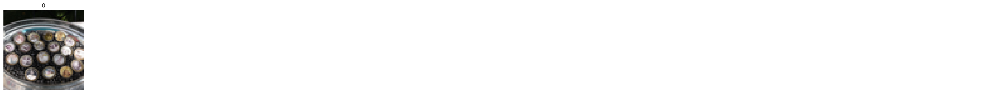

24925


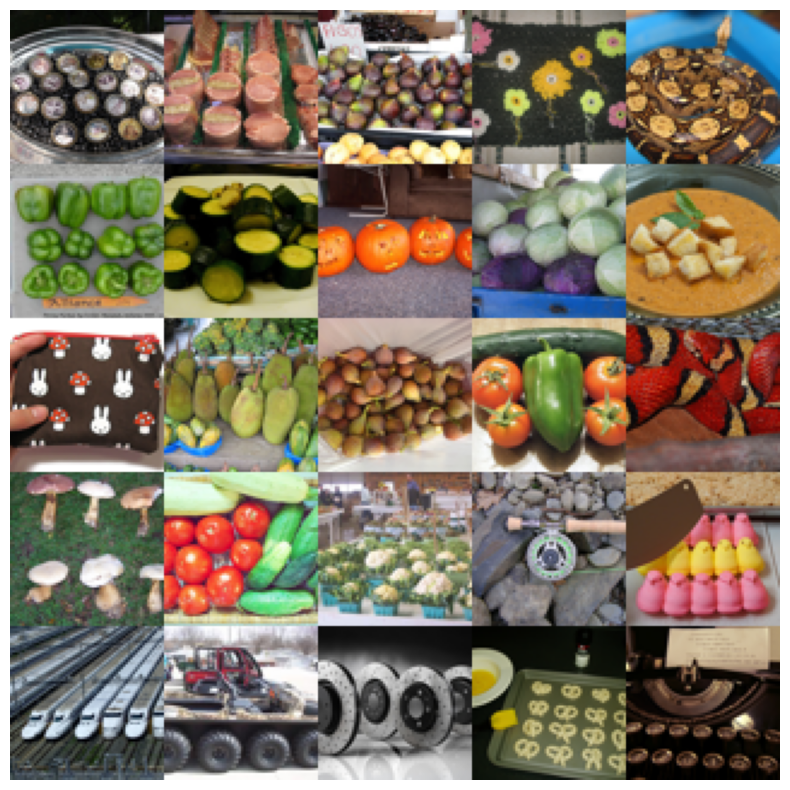

tensor([1.0000, 0.9356, 0.9331, 0.9317, 0.9314, 0.9308, 0.9302, 0.9276, 0.9268,
        0.9261, 0.9246, 0.9226, 0.9214, 0.9207, 0.9202, 0.9200, 0.9195, 0.9192,
        0.9189, 0.9188, 0.9188, 0.9185, 0.9184, 0.9174, 0.9169])


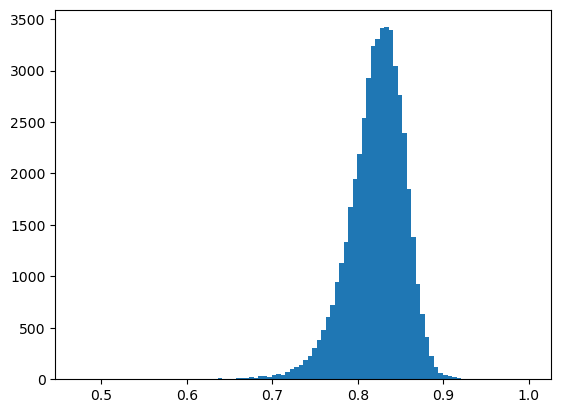

In [26]:
i = torch.randint(0, test_sets_cat.shape[0], (1,)).item()
# i = 20797
i = 24925
# i = 39154
# i = 22548
sig = 150
# cosine_sim = torch.cat(phis[group][sig]) @ torch.cat(phis[group][sig])[i] / (torch.linalg.norm(torch.cat(phis[group][sig]), axis = 1) *  torch.linalg.norm(torch.cat(phis[group][sig])[i]))
show_im_set(test_sets_cat[i:i+1])
print(i)
show_im_grid(test_sets_cat[cosine_sim[i].sort(descending =True)[1][0:25]], n_columns= 5, save_name = '../results/cosine_sim_latent_'+str(i)+'.pdf' )

plt.hist(cosine_sim[i].flatten(), bins =  100);
# plt.xlim(0,1)
print(cosine_sim[i].sort(descending =True)[0][0:25])

Text(0.5, 1.0, '$\\phi$ values for images nearby the target image (error bars)')

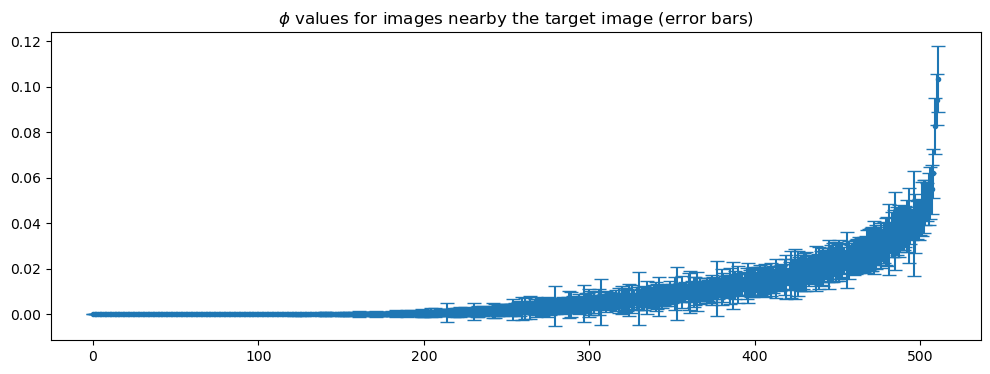

In [27]:
group_ids = cosine_sim[i].sort(descending =True)[1][0:60]
plt.figure(figsize = (12,4))
myides = torch.cat(phis[group][sig]).cpu()[group_ids ].mean(dim = 0).sort()[1]
plt.errorbar( range(512), torch.cat(phis[group][sig]).cpu()[group_ids ].mean(dim = 0).sort()[0], yerr= torch.cat(phis[group][sig]).cpu()[group_ids ].std(dim = 0)[myides] ,  
              fmt =  '.', capsize = 5)
plt.title('$\phi$ values for images nearby the target image (error bars)' )

farthest images from the target 


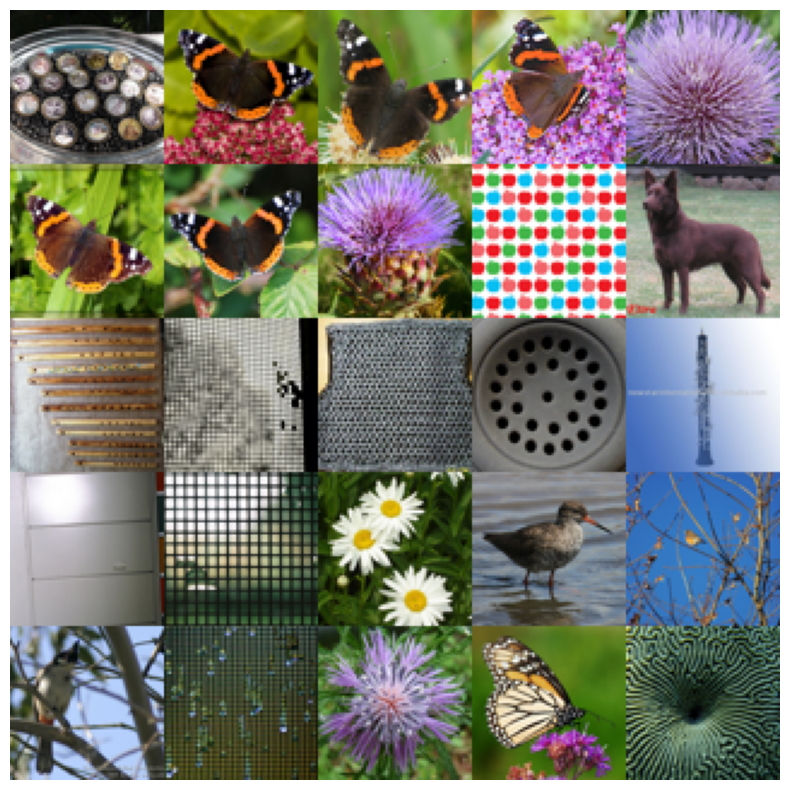

tensor([0.6391, 0.6382, 0.6365, 0.6333, 0.6293, 0.6292, 0.6291, 0.6273, 0.6243,
        0.6235, 0.6213, 0.6210, 0.6203, 0.6118, 0.6076, 0.6023, 0.5999, 0.5981,
        0.5876, 0.5873, 0.5805, 0.5761, 0.5568, 0.5152, 0.4724])


In [28]:
### 
print('farthest images from the target ')
show_im_grid(torch.cat([test_sets_cat[i:i+1],test_sets_cat[cosine_sim[i].sort(descending =True)[1][-24::]][range(23,-1,-1)] ]), n_columns= 5, 
             save_name = '../results/cosine_dissim_latent_'+str(i)+'.pdf' )
print(cosine_sim[i].sort(descending =True)[0][-25::])

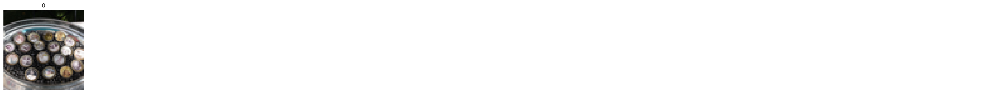

24925


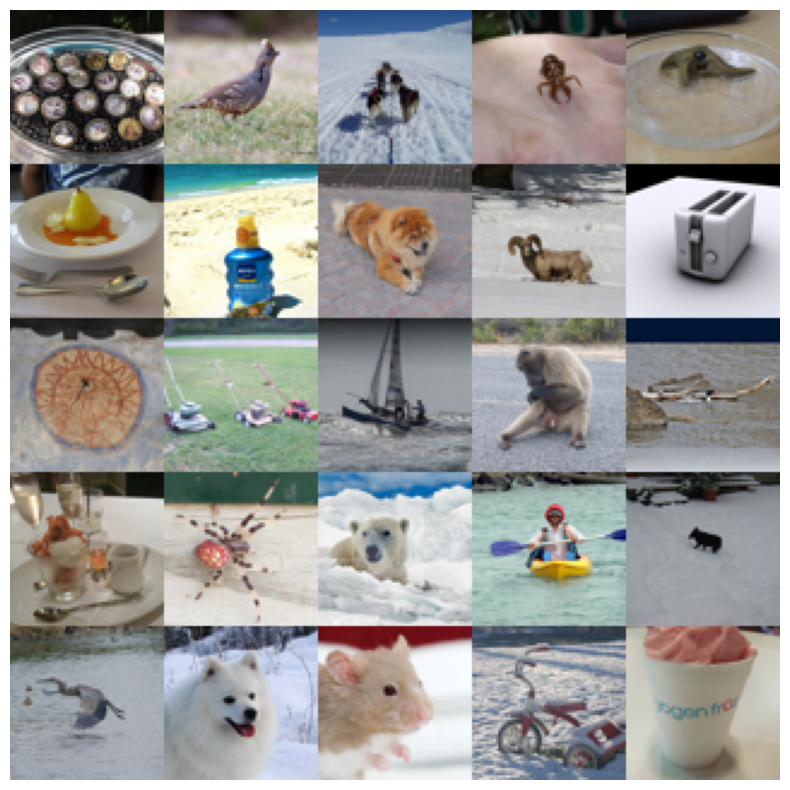

tensor([1.0000, 0.8636, 0.8608, 0.8594, 0.8568, 0.8564, 0.8549, 0.8542, 0.8537,
        0.8527, 0.8521, 0.8518, 0.8517, 0.8517, 0.8511, 0.8511, 0.8509, 0.8500,
        0.8497, 0.8494, 0.8492, 0.8487, 0.8484, 0.8479, 0.8473])


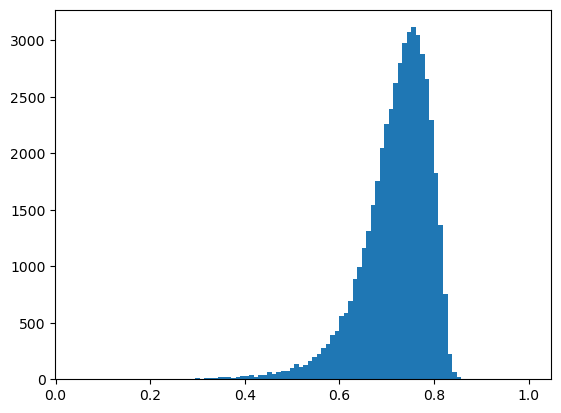

In [29]:
### in pixel domain 
cosine_sim_pix = test_sets_cat.flatten(start_dim = 1) @ test_sets_cat.flatten(start_dim = 1)[i] / (torch.linalg.norm(test_sets_cat.flatten(start_dim = 1), axis = 1) *  torch.linalg.norm(test_sets_cat.flatten(start_dim = 1)[i]))
show_im_set(test_sets_cat[i:i+1])
print(i)
show_im_grid(test_sets_cat[cosine_sim_pix.sort(descending =True)[1][0:25]] , n_columns= 5, save_name = '../results/cosine_sim_pixel_'+str(i)+'.pdf' )
plt.hist(cosine_sim_pix.flatten(), bins =  100);
print(cosine_sim_pix.sort(descending =True)[0][0:25])

## union of subspaces figure 

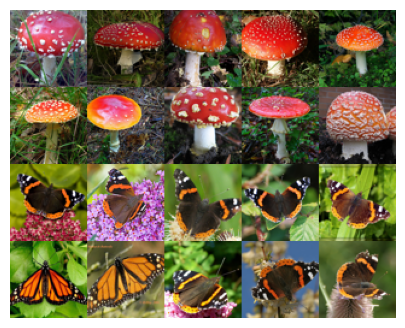

In [30]:
sig = 150

c1 = ids_selectivity_sorted[group][sig][502] # selective channel 
c2 = ids_selectivity_sorted[group][sig][508] # selective channel 
im_set2 = torch.cat(test_sets)[torch.cat(phis[group][sig])[:,c2].cpu().sort(descending = True)[1]][0:10]
im_set1 = torch.cat(test_sets)[torch.cat(phis[group][sig])[:,c1].cpu().sort(descending = True)[1]][0:10]
images_cat = show_im_grid(torch.cat((im_set1, im_set2)), n_columns=5,im_size =1)
                          # save_name='../results/im_examples_group_sparsity_hist.pdf' )


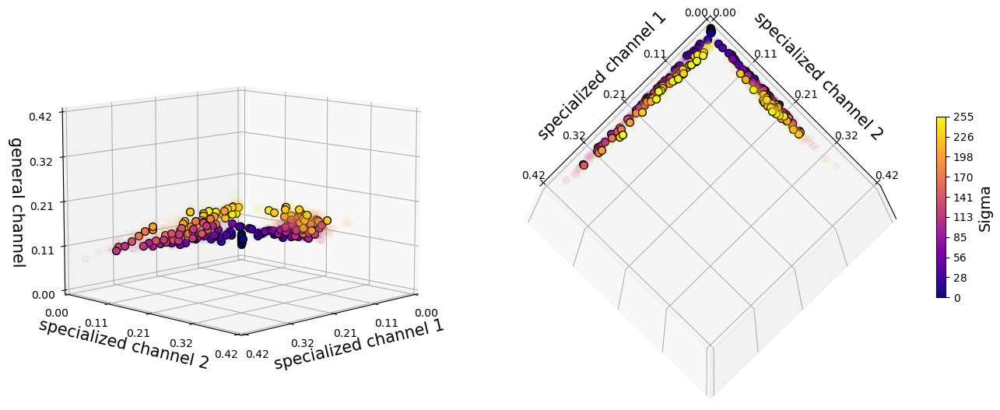

In [31]:
fig = plt.figure(figsize = (15,7 ))
ax = fig.add_subplot(121, projection='3d')
ax.view_init(elev=10, azim= 45 )
# plt.tight_layout()


c0 = ids_selectivity_sorted[group][150][3] # shared channel 
# c0 = 47 # shared channel 

mysigmas = torch.linspace(0,255, 10).int()
# mysigmas = torch.logspace(.0001,2.4, 10).int()

colormap = plt.cm.plasma #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,len(mysigmas))]

ids1 = torch.cat(phis[group][150])[:,c1].cpu().sort(descending = True)[1][0:10]
# ids1 = cos_sims[id1[0]].sort(descending = True)[1][0:10].cpu()
ids2 = torch.cat(phis[group][150])[:,c2].cpu().sort(descending = True)[1][0:10]
# ids2 = cos_sims[id2[0]].sort(descending = True)[1][0:10].cpu()
ax_lim = 0
 
i = 0

for sig in mysigmas:
    phis1 = phi_c_many_noise(denoisers[group], test_sets_cat[ids1] , sigs=torch.ones(len(ids1),1,1,1) * sig/255 , n_noise= 5 )[3].cpu()
    
    phis2 = phi_c_many_noise(denoisers[group], test_sets_cat[ids2], sigs=torch.ones(len(ids2),1,1,1) * sig/255 , n_noise= 5 )[3].cpu()
    
    sc = ax.scatter(phis1.flatten(end_dim=1)[:, c2],phis1.flatten(end_dim=1)[:, c1],phis1.flatten(end_dim=1)[:, c0],
             marker = 'o' , s=40, depthshade=True, color=plot_colors[i] , alpha = .05, zorder=1  )

    sc = ax.scatter(phis1.mean(dim =0)[:, c2],phis1.mean(dim =0)[:, c1],phis1.mean(dim =0)[:, c0],
             marker = 'o',  s=50, edgecolor='black', depthshade=False, color=plot_colors[i],  alpha = 1,zorder=110 )

    
    sc = ax.scatter(phis2.flatten(end_dim=1)[:, c2],phis2.flatten(end_dim=1)[:, c1],phis2.flatten(end_dim=1)[:, c0],
                 marker = 'o' , s=40, depthshade=True, color=plot_colors[ i], alpha = .05, zorder=1  )

    sc = ax.scatter(phis2.mean(dim =0)[:, c2],phis2.mean(dim =0)[:, c1],phis2.mean(dim =0)[:, c0],
             marker = 'o' ,  s=50, edgecolor='black', depthshade=False, color=plot_colors[ i],  alpha = 1,zorder=110 )

    if ax_lim < max(phis2.max(), phis1.max()) :
        ax_lim = max(phis2.max(), phis1.max()) 

    
    i += 1

ax.set_xlim3d(0,ax_lim)
ax.set_ylim3d(0,ax_lim)
ax.set_zlim3d(0,.1)
ticks =np.linspace(0,ax_lim,5)
ax.set_xticks(ticks)      
ax.set_xticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_yticks(ticks)      
ax.set_yticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_zticks(ticks)      
ax.set_zticklabels([f"{tick:.2f}" for tick in ticks])

# Labels
ax.set_xlabel('specialized channel 1', fontsize = 15)
ax.set_ylabel('specialized channel 2', fontsize = 15)
ax.set_zlabel('general channel', fontsize = 15)

###############################

ax = fig.add_subplot(122, projection='3d')
ax.view_init(elev=100, azim= 45 )
# plt.tight_layout()

i = 0

for sig in mysigmas:
    phis1 = phi_c_many_noise(denoisers[group], test_sets_cat[ids1], sigs=torch.ones(len(ids1),1,1,1) * sig/255 , n_noise= 5 )[3].cpu()
    
    phis2 = phi_c_many_noise(denoisers[group], test_sets_cat[ids2], sigs=torch.ones(len(ids2),1,1,1) * sig/255 , n_noise= 5 )[3].cpu()
    
    sc = ax.scatter(phis1.flatten(end_dim=1)[:, c2],phis1.flatten(end_dim=1)[:, c1],phis1.flatten(end_dim=1)[:, c0],
             marker = 'o' , s=40, depthshade=True, color=plot_colors[i] , alpha = .05, zorder=1  )

    sc = ax.scatter(phis1.mean(dim =0)[:, c2],phis1.mean(dim =0)[:, c1],phis1.mean(dim =0)[:, c0],
             marker = 'o',  s=50, edgecolor='black', depthshade=False, color=plot_colors[i],  alpha = 1,zorder=110 )

    
    sc = ax.scatter(phis2.flatten(end_dim=1)[:, c2],phis2.flatten(end_dim=1)[:, c1],phis2.flatten(end_dim=1)[:, c0],
                 marker = 'o' , s=40, depthshade=True, color=plot_colors[i], alpha = .05, zorder=1  )

    sc = ax.scatter(phis2.mean(dim =0)[:, c2],phis2.mean(dim =0)[:, c1],phis2.mean(dim =0)[:, c0],
             marker = 'o' ,  s=50, edgecolor='black', depthshade=False, color=plot_colors[i],  alpha = 1,zorder=110 )

    
    i += 1
ax.set_xlim3d(0,ax_lim)
ax.set_ylim3d(0,ax_lim)
ax.set_zlim3d(0,.1)
ticks =np.linspace(0,ax_lim,5)
ax.set_xticks(ticks)      
ax.set_xticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_yticks(ticks)      
ax.set_yticklabels([f"{tick:.2f}" for tick in ticks])

ax.set_zticks([])      

ax.set_zlabel('') ;      
ax.set_xlabel('specialized channel 1', fontsize = 15)
ax.set_ylabel('specialized channel 2', fontsize = 15);


norm = colors.Normalize(vmin=0, vmax=len(mysigmas)-1)

# Create ScalarMappable for the colorbar
sm = plt.cm.ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])  # required for colorbar

# Add the colorbar to the figure (covers both subplots)
cbar = fig.colorbar(sm, ax=fig.axes, fraction=0.01, pad=0.04)
cbar.set_label("Sigma", fontsize=14)

# Optional: set tick labels to your actual mysigmas values
cbar.set_ticks(range(len(mysigmas)))
cbar.set_ticklabels([f"{sig.item():.0f}" for sig in mysigmas])
# plt.savefig( '../results/group_sparsity.pdf',bbox_inches='tight')    


## three common channels

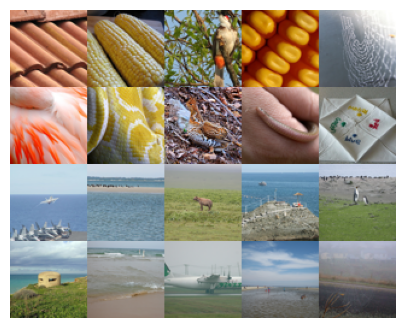

In [32]:
sig = 150
# c1 = 255# selective channel 
# c2 = 506 # selective channel 

c1 = ids_selectivity_sorted[group][sig][1] # selective channel 
c2 = ids_selectivity_sorted[group][sig][2] # selective channel 
im_set2 = torch.cat(test_sets)[torch.cat(phis[group][sig])[:,c2].cpu().sort(descending = True)[1]][0:10]
im_set1 = torch.cat(test_sets)[torch.cat(phis[group][sig])[:,c1].cpu().sort(descending = True)[1]][0:10]
images_cat = show_im_grid(torch.cat((im_set1, im_set2)), n_columns=5,im_size =1)
                          # save_name='../results/im_examples_group_sparsity_hist.pdf' )


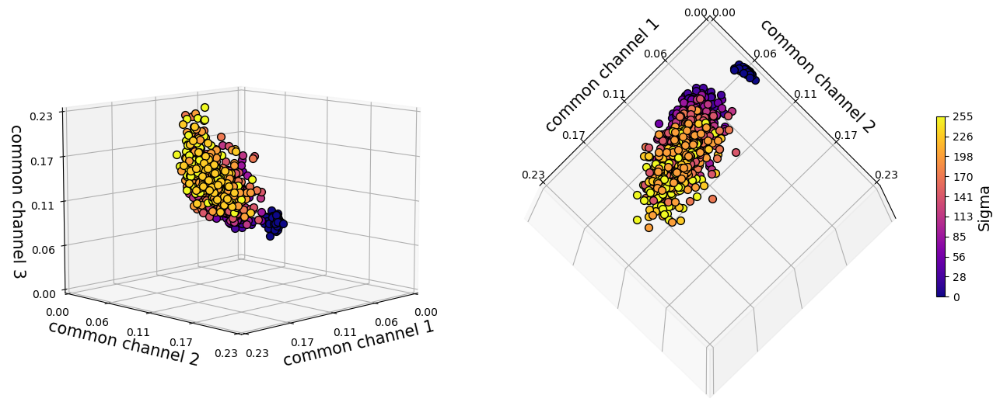

In [33]:
fig = plt.figure(figsize = (15,7 ))
ax = fig.add_subplot(121, projection='3d')
ax.view_init(elev=10, azim= 45 )
# plt.tight_layout()


c0 = ids_selectivity_sorted[group][150][3] # shared channel 
# c0 = 47 # shared channel 

mysigmas = torch.linspace(0,255, 10).int()
# mysigmas = torch.logspace(.0001,2.4, 10).int()

colormap = plt.cm.plasma #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,len(mysigmas))]

ids1 = torch.randint(0,len(test_sets_cat), size = (50,)) 
# ids1 = cos_sims[id1[0]].sort(descending = True)[1][0:10].cpu()
ids2 = torch.randint(0,len(test_sets_cat), size = (50,)) 
# ids2 = cos_sims[id2[0]].sort(descending = True)[1][0:10].cpu()
ax_lim = 0
 
i = 0

for sig in mysigmas:
    phis1 = phi_c_many_noise(denoisers[group], test_sets_cat[ids1] , sigs=torch.ones(len(ids1),1,1,1) * sig/255 , n_noise= 1 )[3].cpu()
    
    phis2 = phi_c_many_noise(denoisers[group], test_sets_cat[ids2], sigs=torch.ones(len(ids2),1,1,1) * sig/255 , n_noise= 1 )[3].cpu()
    
    sc = ax.scatter(phis1.flatten(end_dim=1)[:, c2],phis1.flatten(end_dim=1)[:, c1],phis1.flatten(end_dim=1)[:, c0],
             marker = 'o' , s=40, depthshade=True, color=plot_colors[i] , alpha = .05, zorder=1  )

    sc = ax.scatter(phis1.mean(dim =0)[:, c2],phis1.mean(dim =0)[:, c1],phis1.mean(dim =0)[:, c0],
             marker = 'o',  s=50, edgecolor='black', depthshade=False, color=plot_colors[i],  alpha = 1,zorder=110 )

    
    sc = ax.scatter(phis2.flatten(end_dim=1)[:, c2],phis2.flatten(end_dim=1)[:, c1],phis2.flatten(end_dim=1)[:, c0],
                 marker = 'o' , s=40, depthshade=True, color=plot_colors[ i], alpha = .05, zorder=1  )

    sc = ax.scatter(phis2.mean(dim =0)[:, c2],phis2.mean(dim =0)[:, c1],phis2.mean(dim =0)[:, c0],
             marker = 'o' ,  s=50, edgecolor='black', depthshade=False, color=plot_colors[ i],  alpha = 1,zorder=110 )

    if ax_lim < max(phis2.max(), phis1.max()) :
        ax_lim = max(phis2.max(), phis1.max()) 

    
    i += 1

ax.set_xlim3d(0,ax_lim)
ax.set_ylim3d(0,ax_lim)
ax.set_zlim3d(0,.1)
ticks =np.linspace(0,ax_lim,5)
ax.set_xticks(ticks)      
ax.set_xticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_yticks(ticks)      
ax.set_yticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_zticks(ticks)      
ax.set_zticklabels([f"{tick:.2f}" for tick in ticks])

# Labels
ax.set_xlabel('common channel 1', fontsize = 15)
ax.set_ylabel('common channel 2', fontsize = 15)
ax.set_zlabel('common channel 3', fontsize = 15)

###############################

ax = fig.add_subplot(122, projection='3d')
ax.view_init(elev=100, azim= 45 )
# plt.tight_layout()

i = 0

for sig in mysigmas:
    phis1 = phi_c_many_noise(denoisers[group], test_sets_cat[ids1], sigs=torch.ones(len(ids1),1,1,1) * sig/255 , n_noise= 1 )[3].cpu()
    
    phis2 = phi_c_many_noise(denoisers[group], test_sets_cat[ids2], sigs=torch.ones(len(ids2),1,1,1) * sig/255 , n_noise= 1 )[3].cpu()
    
    sc = ax.scatter(phis1.flatten(end_dim=1)[:, c2],phis1.flatten(end_dim=1)[:, c1],phis1.flatten(end_dim=1)[:, c0],
             marker = 'o' , s=40, depthshade=True, color=plot_colors[i] , alpha = .05, zorder=1  )

    sc = ax.scatter(phis1.mean(dim =0)[:, c2],phis1.mean(dim =0)[:, c1],phis1.mean(dim =0)[:, c0],
             marker = 'o',  s=50, edgecolor='black', depthshade=False, color=plot_colors[i],  alpha = 1,zorder=110 )

    
    sc = ax.scatter(phis2.flatten(end_dim=1)[:, c2],phis2.flatten(end_dim=1)[:, c1],phis2.flatten(end_dim=1)[:, c0],
                 marker = 'o' , s=40, depthshade=True, color=plot_colors[i], alpha = .05, zorder=1  )

    sc = ax.scatter(phis2.mean(dim =0)[:, c2],phis2.mean(dim =0)[:, c1],phis2.mean(dim =0)[:, c0],
             marker = 'o' ,  s=50, edgecolor='black', depthshade=False, color=plot_colors[i],  alpha = 1,zorder=110 )

    
    i += 1
ax.set_xlim3d(0,ax_lim)
ax.set_ylim3d(0,ax_lim)
ax.set_zlim3d(0,.1)
ticks =np.linspace(0,ax_lim,5)
ax.set_xticks(ticks)      
ax.set_xticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_yticks(ticks)      
ax.set_yticklabels([f"{tick:.2f}" for tick in ticks])

ax.set_zticks([])      

ax.set_zlabel('') ;      
ax.set_xlabel('common channel 1', fontsize = 15)
ax.set_ylabel('common channel 2', fontsize = 15);


norm = colors.Normalize(vmin=0, vmax=len(mysigmas)-1)

# Create ScalarMappable for the colorbar
sm = plt.cm.ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])  # required for colorbar

# Add the colorbar to the figure (covers both subplots)
cbar = fig.colorbar(sm, ax=fig.axes, fraction=0.01, pad=0.04)
cbar.set_label("Sigma", fontsize=14)

# Optional: set tick labels to your actual mysigmas values
cbar.set_ticks(range(len(mysigmas)))
cbar.set_ticklabels([f"{sig.item():.0f}" for sig in mysigmas])
# plt.savefig( '../results/group_sparsity.pdf',bbox_inches='tight')    


## For the paper 

In [34]:
c1 = 255# selective channel 
c2 = 506 # selective channel 


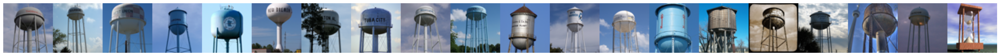

In [35]:
sig = 150
show_im_grid(torch.cat(test_sets)[torch.cat(phis[group][sig])[:,c1].cpu().sort(descending = True)[1]][0:20], n_columns=20)

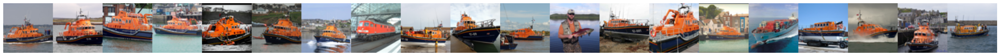

In [36]:
show_im_grid(torch.cat(test_sets)[torch.cat(phis[group][sig])[:,c2].cpu().sort(descending = True)[1]][0:20], n_columns=20)

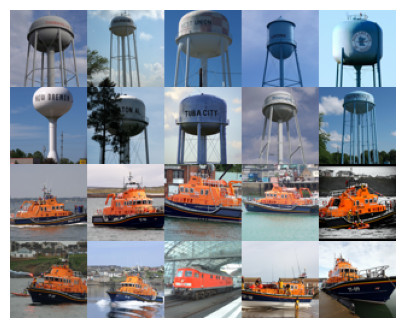

In [37]:
im_set2 = torch.cat(test_sets)[torch.cat(phis[group][150])[:,c2].cpu().sort(descending = True)[1]][0:10]
im_set1 = torch.cat(test_sets)[torch.cat(phis[group][150])[:,c1].cpu().sort(descending = True)[1]][0:10]
images_cat = show_im_grid(torch.cat((im_set1, im_set2)), n_columns=5,im_size =1)
                          # save_name='../results/im_examples_group_sparsity_hist.pdf' )


In [36]:
cos_sims = similarity_matrix(torch.cat(phis[group][150]) )
cos_sims.shape

torch.Size([49051, 49051])

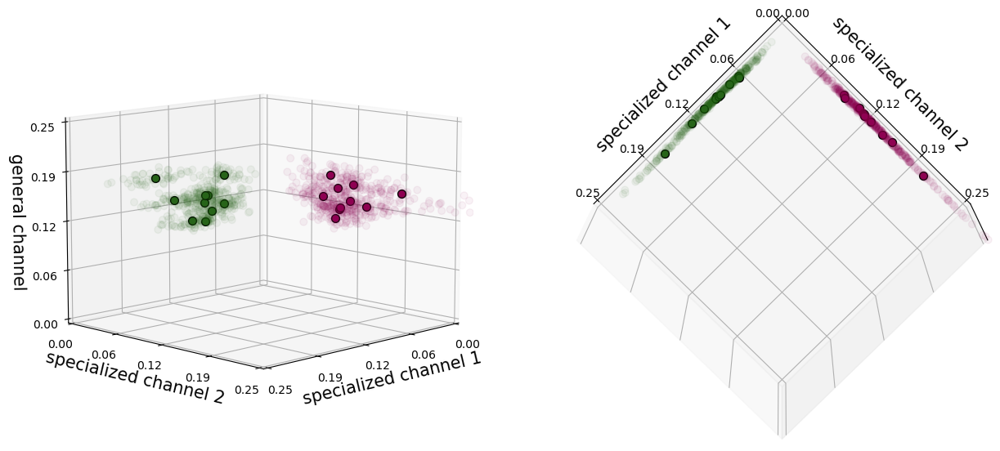

In [37]:
fig = plt.figure(figsize = (15,7 ))
ax = fig.add_subplot(121, projection='3d')
ax.view_init(elev=10, azim= 45 )
# plt.tight_layout()


group = 'mixture-color-deep-no-skip'
c0 = 47 # shared channel 
mysigmas = torch.linspace(150,150, 1)
colormap = plt.cm.PiYG #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1,2)]

ids1 = torch.cat(phis[group][150])[:,c1].cpu().sort(descending = True)[1][0:10]
# ids1 = cos_sims[id1[0]].sort(descending = True)[1][0:10].cpu()
ids2 = torch.cat(phis[group][150])[:,c2].cpu().sort(descending = True)[1][0:10]
# ids2 = cos_sims[id2[0]].sort(descending = True)[1][0:10].cpu()

 
i = 0

for sig in mysigmas:
    phis1 = phi_c_many_noise(denoisers[group], test_sets_cat[ids1], sigs=torch.ones(len(ids1),1,1,1) * sig/255 , n_noise= 50 )[3].cpu()
    
    phis2 = phi_c_many_noise(denoisers[group], test_sets_cat[ids2], sigs=torch.ones(len(ids2),1,1,1) * sig/255 , n_noise= 50 )[3].cpu()
    
    sc = ax.scatter(phis1.flatten(end_dim=1)[:, c2],phis1.flatten(end_dim=1)[:, c1],phis1.flatten(end_dim=1)[:, c0],
             marker = 'o' , s=40, depthshade=True, color=plot_colors[0] , alpha = .05, zorder=1  )

    sc = ax.scatter(phis1.mean(dim =0)[:, c2],phis1.mean(dim =0)[:, c1],phis1.mean(dim =0)[:, c0],
             marker = 'o',  s=50, edgecolor='black', depthshade=False, color=plot_colors[0],  alpha = 1,zorder=110 )

    
    sc = ax.scatter(phis2.flatten(end_dim=1)[:, c2],phis2.flatten(end_dim=1)[:, c1],phis2.flatten(end_dim=1)[:, c0],
                 marker = 'o' , s=40, depthshade=True, color=plot_colors[1], alpha = .05, zorder=1  )

    sc = ax.scatter(phis2.mean(dim =0)[:, c2],phis2.mean(dim =0)[:, c1],phis2.mean(dim =0)[:, c0],
             marker = 'o' ,  s=50, edgecolor='black', depthshade=False, color=plot_colors[1],  alpha = 1,zorder=110 )

    
    i += 1

ax.set_xlim3d(0,.25)
ax.set_ylim3d(0,.25)
ax.set_zlim3d(0,.25)
ticks =np.linspace(0,.25,5)
ax.set_xticks(ticks)      
ax.set_xticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_yticks(ticks)      
ax.set_yticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_zticks(ticks)      
ax.set_zticklabels([f"{tick:.2f}" for tick in ticks])

# Labels
ax.set_xlabel('specialized channel 1', fontsize = 15)
ax.set_ylabel('specialized channel 2', fontsize = 15)
ax.set_zlabel('general channel', fontsize = 15)

###############################

ax = fig.add_subplot(122, projection='3d')
ax.view_init(elev=100, azim= 45 )
# plt.tight_layout()

i = 0

for sig in mysigmas:
    phis1 = phi_c_many_noise(denoisers[group], test_sets_cat[ids1], sigs=torch.ones(len(ids1),1,1,1) * sig/255 , n_noise= 50 )[3].cpu()
    
    phis2 = phi_c_many_noise(denoisers[group], test_sets_cat[ids2], sigs=torch.ones(len(ids2),1,1,1) * sig/255 , n_noise= 50 )[3].cpu()
    
    sc = ax.scatter(phis1.flatten(end_dim=1)[:, c2],phis1.flatten(end_dim=1)[:, c1],phis1.flatten(end_dim=1)[:, c0],
             marker = 'o' , s=40, depthshade=True, color=plot_colors[0] , alpha = .05, zorder=1  )

    sc = ax.scatter(phis1.mean(dim =0)[:, c2],phis1.mean(dim =0)[:, c1],phis1.mean(dim =0)[:, c0],
             marker = 'o',  s=50, edgecolor='black', depthshade=False, color=plot_colors[0],  alpha = 1,zorder=110 )

    
    sc = ax.scatter(phis2.flatten(end_dim=1)[:, c2],phis2.flatten(end_dim=1)[:, c1],phis2.flatten(end_dim=1)[:, c0],
                 marker = 'o' , s=40, depthshade=True, color=plot_colors[1], alpha = .05, zorder=1  )

    sc = ax.scatter(phis2.mean(dim =0)[:, c2],phis2.mean(dim =0)[:, c1],phis2.mean(dim =0)[:, c0],
             marker = 'o' ,  s=50, edgecolor='black', depthshade=False, color=plot_colors[1],  alpha = 1,zorder=110 )

    
    i += 1
ax.set_xlim3d(0,.25)
ax.set_ylim3d(0,.25)
ax.set_zlim3d(0,.25)
ticks =np.linspace(0,.25,5)
ax.set_xticks(ticks)      
ax.set_xticklabels([f"{tick:.2f}" for tick in ticks])
ax.set_yticks(ticks)      
ax.set_yticklabels([f"{tick:.2f}" for tick in ticks])

ax.set_zticks([])      

ax.set_zlabel('') ;      
ax.set_xlabel('specialized channel 1', fontsize = 15)
ax.set_ylabel('specialized channel 2', fontsize = 15);


# plt.savefig( '../results/group_sparsity.pdf',bbox_inches='tight')    


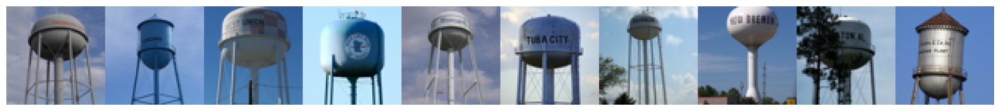

In [38]:
show_im_grid( test_sets_cat[cos_sims[ids1[0]].sort(descending = True)[1][0:10].cpu()] )

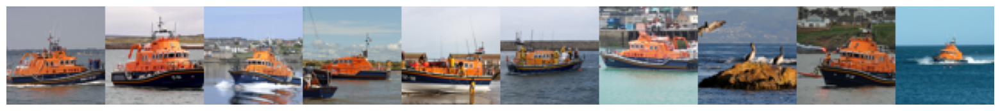

In [39]:
show_im_grid( test_sets_cat[cos_sims[ids2[0]].sort(descending = True)[1][0:10].cpu()] )

## similarities between $\phi$'s

In [98]:
sim_matrix_truncated = {}
sim_matrix = {}
for sig in [10,50, 150, 255]:
    sim_matrix_truncated[sig] = similarity_matrix(torch.cat(phis[group][sig]).cpu()[:,ids_selectivity_sorted[group][sig]].cpu()[:, 200::] )
    sim_matrix[sig] = similarity_matrix(torch.cat(phis[group][sig]).cpu()[:,ids_selectivity_sorted[group][sig].cpu()])

sim_matrix[sig].shape

torch.Size([49051, 49051])

In [99]:
sim_matrix_truncated[sig].shape


torch.Size([49051, 49051])

(0.0, 1.0)

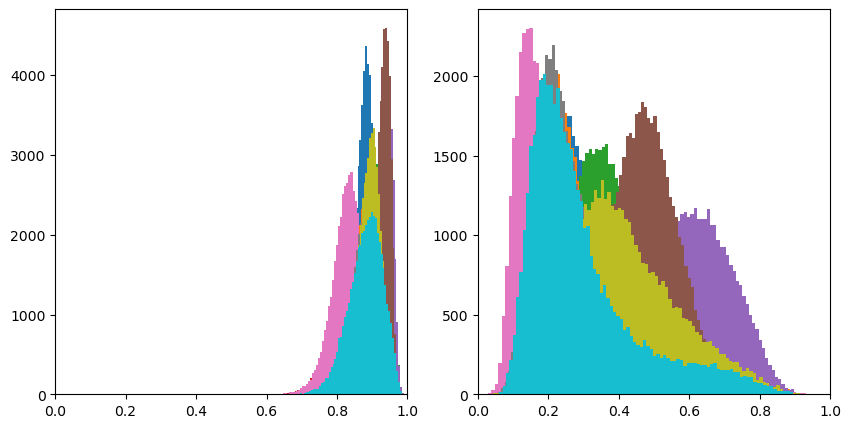

In [101]:
f, axs = plt.subplots(1,2, figsize = (10, 5) )
for im_n in range(10): 
    axs[0].hist(sim_matrix[sig][im_n] .cpu(), bins = 100)
    axs[1].hist(sim_matrix_truncated[sig][im_n] .cpu(), bins = 100)
axs[0].set_xlim(0,1)
axs[1].set_xlim(0,1)

$\phi$ are more seperated at intermediate noise levels. The trend makes sense: at small noise levels, there is no need to seperate the representations because denoising requires only local information. At intermediate noise levels, $\phi$ are more seperated. At large noise, they become more correlated again because more information are burried. 

6641


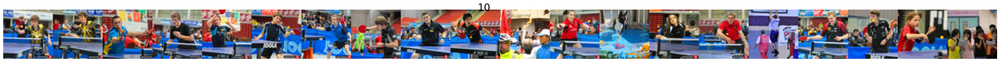

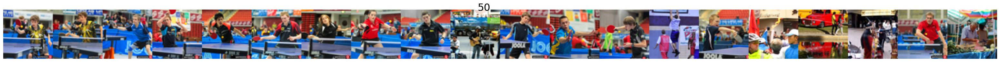

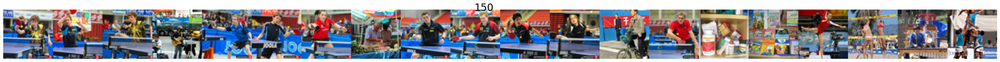

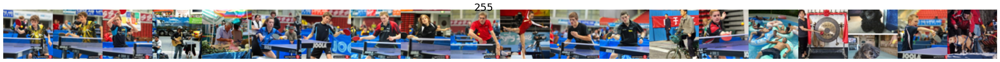

In [141]:
im_n = torch.randint(low=0, high=len(test_sets_cat),size=( 1,)).item()
# im_n = 24925 
# im_n = 666
# im_n = 6641
print(im_n)

for sig in [10, 50, 150, 255]:
    show_im_grid(test_sets_cat[sim_matrix[sig][im_n].topk(20)[1].cpu()] , n_columns=20, label= sig)
    # show_im_grid(test_sets_cat[sim_matrix_truncated[sig][im_n].topk(60)[1].cpu()] , n_columns=20)

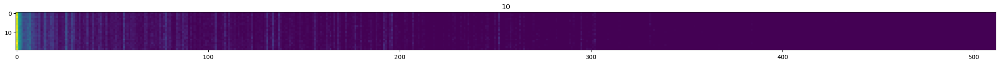

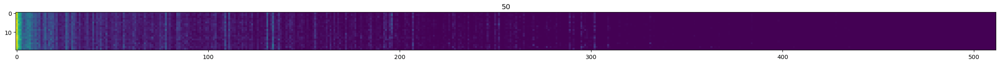

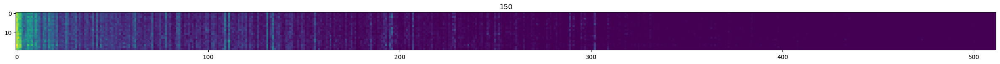

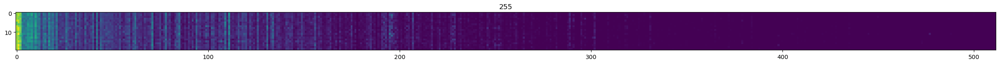

In [142]:

for sig in [10, 50, 150, 255]:

    plt.figure(figsize = (30,3))
    plt.imshow(torch.cat(phis[group][sig]).cpu()[sim_matrix[sig][im_n].topk(20)[1] ][:,ids_selectivity_sorted[group][50] ] )
    plt.title(sig)
    

## Are the $\phi$ Clustered? 

### averaged over noise samples 

In [10]:
# with open('../results/kmeans_noise_ave_mixture-color-no-skip-deep_imagenet_cluster_sizes.pkl', 'rb') as f:
    # kmeans_results = pickle.load(f)

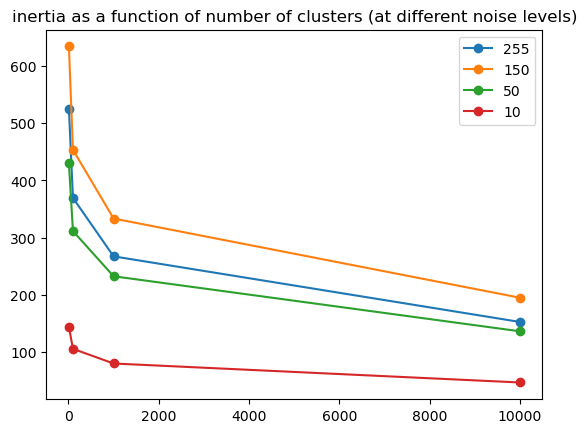

In [44]:
for sig in kmeans_results.keys():
    plt.plot([n for n in kmeans_results[sig].keys()], [kmeans_results[sig][n].inertia_ for n in kmeans_results[sig].keys()], '-o', label = sig)
plt.legend()
plt.title('inertia as a function of number of clusters (at different noise levels)');
# plt.xscale('log')

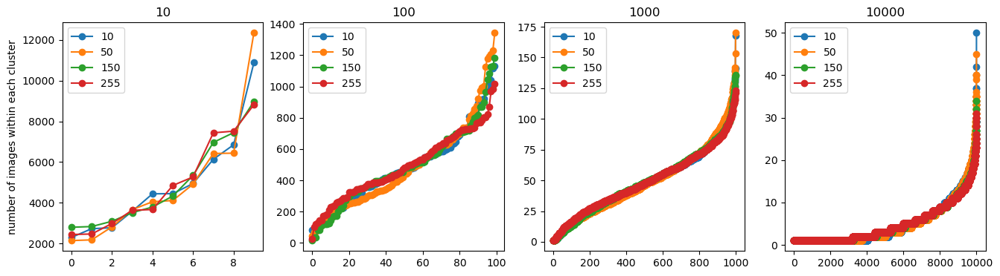

In [46]:
f, axs = plt.subplots(1, len(kmeans_results[10].keys()) , figsize = (len(kmeans_results[10].keys()) * 4, 4))
i = 0 
for n_clusters in kmeans_results[255].keys():
    for sig in sigmas:
        labels = torch.tensor(kmeans_results[sig][n_clusters].labels_)
        
        values, counts = torch.unique(labels, return_counts=True)
        axs[i].plot(range(n_clusters), counts.sort()[0], '-o', alpha = 1, label = sig)
        axs[0].set_ylabel('number of images within each cluster')
        axs[i].legend()
        axs[i].set_title(n_clusters)

    i += 1    

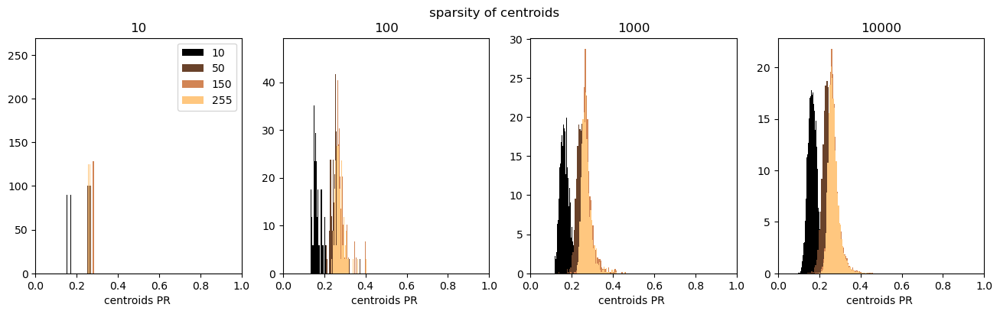

In [51]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1,len(sigmas))]
plot_colors2 = [scale_colormap(i) for i in np.linspace(0, 1,len(sigmas))]

f, axs = plt.subplots(1, len(kmeans_results[sig].keys()), figsize = (len(kmeans_results[sig].keys()) * 4,4) )
plt.suptitle('sparsity of centroids');

j = 0
for n_clusters in kmeans_results[sig].keys():
    for i in range(len(sigmas)):
        sig = sigmas[i]
        axs[j].hist(participation_ratio_dataset(torch.tensor(kmeans_results[sig][n_clusters].cluster_centers_)), bins = 50, color=plot_colors[i], label = sig, density = True);
        # axs[j].hist(participation_ratio_dataset(torch.cat(phis[group][sig])).cpu(), bins = 50, color=plot_colors2[i], label = sig, alpha = .3 , density = True );
        
    axs[j].set_xlim(0,1)
    axs[0].legend()
    axs[j].set_title(n_clusters)
    axs[j].set_xlabel('centroids PR ');
    j = j+ 1
    

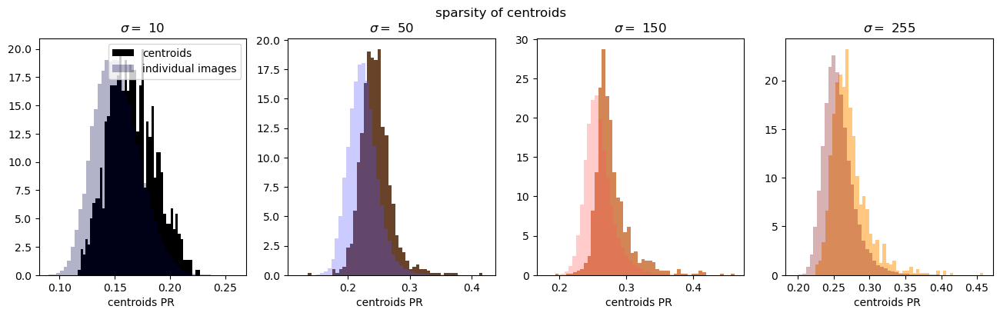

In [61]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1,len(sigmas))]
plot_colors2 = [scale_colormap(i) for i in np.linspace(0, 1,len(sigmas))]

f, axs = plt.subplots(1, len(kmeans_results[sig].keys()), figsize = (len(kmeans_results[sig].keys()) * 4,4) )
plt.suptitle('sparsity of centroids');

n_clusters  = 1000
for i in range(len(sigmas)):
    sig = sigmas[i]
    axs[i].hist(participation_ratio_dataset(torch.tensor(kmeans_results[sig][n_clusters].cluster_centers_)), bins = 50, color=plot_colors[i], label = 'centroids', density = True);
    axs[i].hist(participation_ratio_dataset(torch.cat(phis[group][sig])).cpu(), bins = 50, color=plot_colors2[i], label = 'individual images', alpha = .3 , density = True );
    
    # axs[i].set_xlim(0,1)
    axs[0].legend()
    axs[i].set_title( '$\sigma= $ ' + str( sig))
    axs[i].set_xlabel('centroids PR ');


In [43]:


## similarity between phi1 and phi2 at different noise levels and diffrent blocks 
group = 'mixture-color-deep-no-skip'
ave_sims = []

for n_clusters in kmeans_results[sig].keys():
    print(n_clusters)
    temp =  []
    for sig in sigmas:
        sim_mat = similarity_matrix(torch.tensor(kmeans_results[sig][n_clusters].cluster_centers_) ).cpu()
        triu_indices = torch.triu_indices(sim_mat.size(0), sim_mat.size(1), offset=1)
        upper_triangle = sim_mat[triu_indices[0], triu_indices[1]]
        temp.append(upper_triangle.mean())        
    
    ave_sims.append(torch.stack(temp))
    


10
100
1000
10000


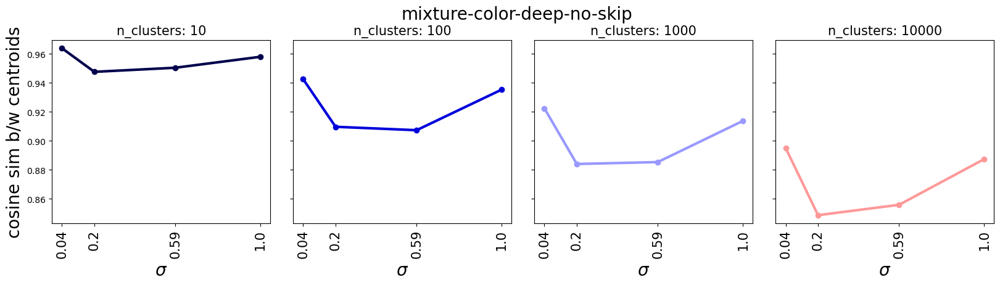

In [42]:
f, axs = plt.subplots(1,len(kmeans_results[sig].keys()) , figsize = (16,4), sharey=True)
f.suptitle(group, fontsize = 20)
plt.tight_layout()

colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [scale_colormap(i) for i in np.linspace(0, 1, len(layers[group]) )]
for i in range(len(kmeans_results[sig].keys()) ): 
    n_clusters = list(kmeans_results[sig].keys())[i]
    axs[i].plot(sigmas, torch.stack(ave_sims)[i], '-o' , color = plot_colors[i], lw = 3)
    axs[i].set_title('n_clusters: ' +str(n_clusters), fontsize = 15)
    axs[i].set_xlabel('$\sigma$', fontsize = 20)
    axs[i].set_xticks(sigmas)
    axs[i].set_xticklabels(np.round(np.array(sigmas)/255,2 ), rotation=90, fontsize = 15)
    
    # axs[b].set_xscale('log')
axs[0].set_ylabel('cosine sim b/w centroids', fontsize = 20);


centroids are less sparse than the $\phi$'s: not all the $\phi$'s lie in the same subpace! Failure of clustering? 

## cluster stability over noise levels 

In [38]:
with open('../results/kmeans_noise_ave_mixture-color-no-skip-deep_imagenet.pkl', 'rb') as f:
    kmeans_results = pickle.load(f)

In [42]:
kmeans_results.keys()

dict_keys([255, 150, 50, 10])

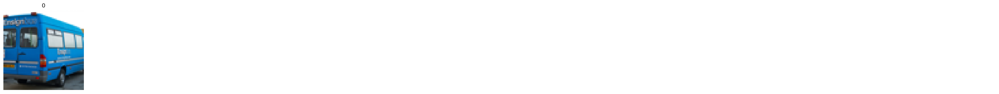

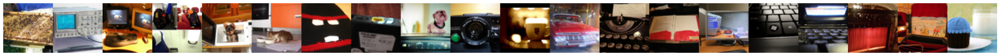

cluster size at noise  255 :  45


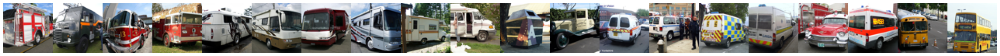

cluster size at noise  150 :  52


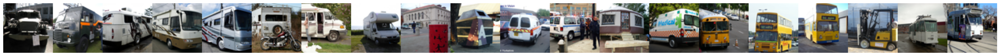

cluster size at noise  50 :  45


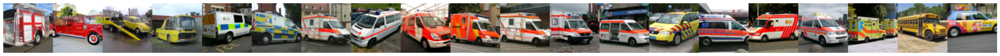

cluster size at noise  10 :  33


In [47]:
n_clusters = 999
im_n = torch.randint(0,len(test_sets_cat), (1,)).item()
show_im_set(test_sets_cat[im_n:im_n+1])
masks = {}
for sig in kmeans_results.keys():
    masks[sig] = kmeans_results[sig][n_clusters].labels_  == kmeans_results[sig][n_clusters].labels_[im_n] 
    show_im_grid(test_sets_cat[masks[sig]][0:20], n_columns=20)
    print('cluster size at noise ', sig ,': ', masks[sig].sum())

## cosine similarity matrix 

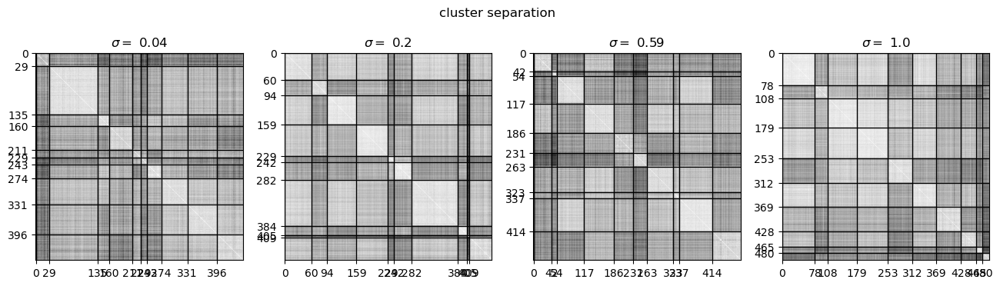

In [158]:
n_clusters = 1000
f, axs = plt.subplots(1,4, figsize = (16, 4))
f.suptitle('cluster separation')

# label_range = range(30, 40)
label_range = torch.randint(0, len(test_sets), size = (10,))
for i in range(len(sigmas)):
    sig = sigmas[i]
    reorderd_phis = torch.cat([torch.cat(phis[group][sig])[kmeans_results[sig][n_clusters].labels_ == c] for c in label_range])
    lines = []
    for l in label_range:
        lines.append((kmeans_results[sig][n_clusters].labels_ == l).sum())
    ticks = [np.array(lines[0:l]).sum() for l in range(len(lines)) ]

    axs[i].set_xticks(ticks )
    axs[i].set_yticks(ticks )
    
    axs[i].grid(color='k', linestyle='-', linewidth=1)

    axs[i].imshow(similarity_matrix(reorderd_phis).cpu(), 'gray')
    axs[i].set_title(f'$\sigma = $ {round(sig /255, 2)}')


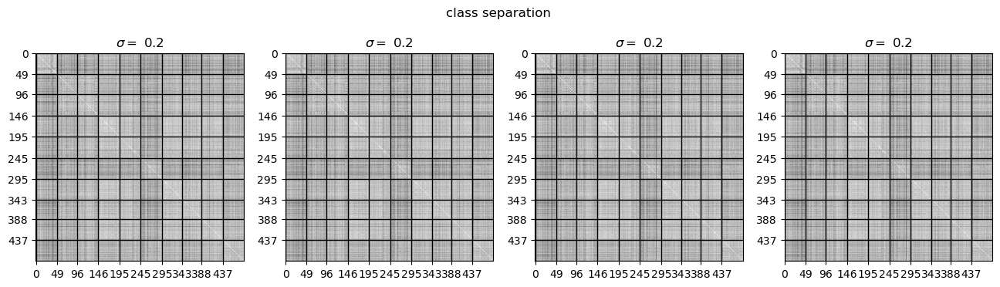

In [52]:
f, axs = plt.subplots(1,4, figsize = (16, 4))
f.suptitle('class separation')
for i in range(len(sigmas)):
    sig = sigmas[1]
    reorderd_phis = torch.cat(phis[group][sig][0:10] )
    lines = []
    for l in range(0, 10):
        lines.append( phis[group][sig][l].shape[0] )
    ticks = [np.array(lines[0:l]).sum() for l in range(len(lines)) ]

    axs[i].set_xticks(ticks )
    axs[i].set_yticks(ticks )
    
    axs[i].grid(color='k', linestyle='-', linewidth=1)

    axs[i].imshow(similarity_matrix(reorderd_phis).cpu(), 'gray')
    axs[i].set_title(f'$\sigma = $ {round(sig /255, 2)}')

## d-prime for classes




In [131]:
## class centroids
class_centroids = {}
for sig in sigmas:
    temp = []
    for label in range(len(test_sets)):
        within_cluster_phis = phis[group][sig][label]
        temp.append(within_cluster_phis.mean(dim = 0))
    class_centroids[sig] = torch.stack(temp)

In [132]:
## paiwise distances between all class centroids
class_centroids_D = {}
for sig in sigmas:
    norms = (class_centroids[sig]**2).sum(dim = 1).unsqueeze(1)
    class_centroids_D_squared = norms + norms.T - 2 * class_centroids[sig] @ class_centroids[sig].T
    class_centroids_D[sig] = torch.sqrt(torch.clamp(class_centroids_D_squared, min=0.0)) 


In [133]:
## compute dprime 
label1_ids = random.sample(range(n_clusters), 100)

all_diffs_classes = {}
all_vars_classes ={}

for sig in sigmas:
    all_diffs_classes[sig] =[]
    all_vars_classes[sig] =[]    
    for label1 in label1_ids:
        ids = class_centroids_D[sig][label1].sort()[1][0:10 ] # closest 10 centroids to label1 
        
        for label2 in ids.cpu():
            cent_diff = class_centroids[sig][label1]  - class_centroids[sig][label2]
            
            within_cluster_phis1 = phis[group][sig][label1]    
            within_cluster_phis2 = phis[group][sig][label2]    
            
            d = cent_diff/ cent_diff.norm()    
            var1 = (((within_cluster_phis1 - class_centroids[sig][label1]) @ d)**2).mean()
            var2 = (((within_cluster_phis2 - class_centroids[sig][label2]) @ d)**2).mean()            
            pooled_var = torch.sqrt( var1 + var2 )
            
                
            all_diffs_classes[sig].append( cent_diff.norm().item() )
            all_vars_classes[sig].append( pooled_var.item() )


## d-prime for clusters 

In [153]:
## class centroids
n_clusters = 1000

cluster_centroids = {}
for sig in sigmas:
    cluster_centroids[sig] =  torch.tensor(kmeans_results[sig][n_clusters].cluster_centers_).to(device)

In [154]:
## paiwise distances between all class centroids
cluster_centroids_D = {}
for sig in sigmas:
    norms = (cluster_centroids[sig]**2).sum(dim = 1).unsqueeze(1)
    cluster_centroids_D_squared = norms + norms.T - 2 * cluster_centroids[sig] @ cluster_centroids[sig].T
    cluster_centroids_D[sig] = torch.sqrt(torch.clamp(cluster_centroids_D_squared, min=0.0)) 


In [155]:
## compute dprime 
all_diffs_clusters = {}
all_vars_clusters ={}
label1_ids = random.sample(range(n_clusters), 100)
for sig in sigmas:
    labels = torch.tensor(kmeans_results[sig][n_clusters].labels_)
    all_diffs_clusters[sig] =[]
    all_vars_clusters[sig] =[]    
    for label1 in label1_ids:
        
        ids = cluster_centroids_D[sig][label1].sort()[1][0:10 ] # closest 10 centroids to label1 
        
        for label2 in ids.cpu():
            cent_diff = cluster_centroids[sig][label1]  - cluster_centroids[sig][label2]
            
            within_cluster_phis1 = torch.cat(phis[group][sig])[labels == label1]
            within_cluster_phis2 = torch.cat(phis[group][sig])[labels == label2]    
    
            d = cent_diff/ cent_diff.norm()    
            var1 = (((within_cluster_phis1 - cluster_centroids[sig][label1]) @ d)**2).mean()
            var2 = (((within_cluster_phis2 - cluster_centroids[sig][label2]) @ d)**2).mean()       
            pooled_var = torch.sqrt( var1 + var2 )
            
                
            all_diffs_clusters[sig].append( cent_diff.norm().item() )
            all_vars_clusters[sig].append( pooled_var.item() )


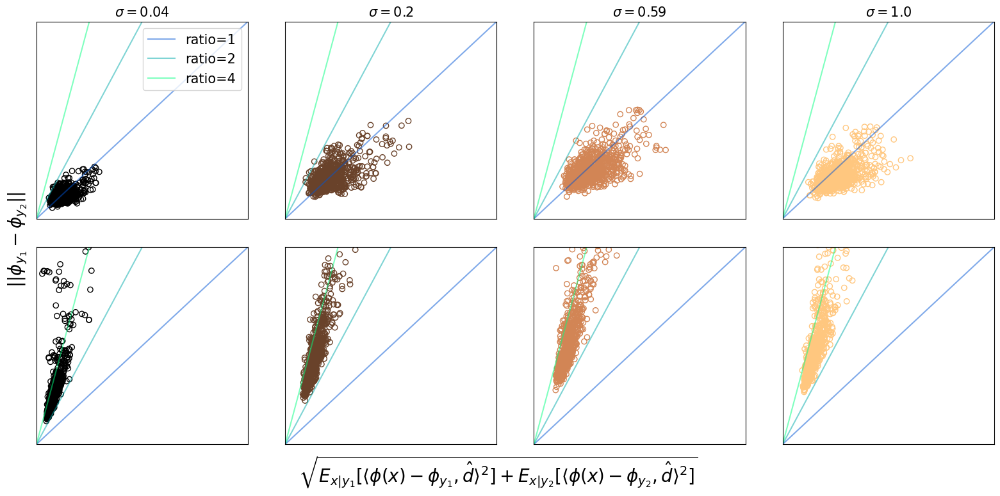

In [156]:
f, axs = plt.subplots(2,4, figsize = (16,8), sharex=False, sharey=False)
plt.tight_layout(rect=[.02, .05, 1, .95])  # Leaves less space at the bottom
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors_copper = [colormap(i) for i in np.linspace(0, 1,len(sigmas))]

colormap = plt.cm.winter #nipy_spectral, Set1,Paired   
plot_colors_spectral = [colormap(i) for i in np.linspace(0, 1,4 )][1::]

for i in range(len(sigmas)):
    sig = sigmas[i]
    axs[0,i].scatter(all_vars_classes[sig] ,all_diffs_classes[sig],  alpha = 1, facecolors='none',
                     color=plot_colors_copper[i]);
    for r in range(3):
        axs[0,i].plot([0,2],[0,2**(r+1)], color=plot_colors_spectral[r],label = 'ratio='+str(2**r) , alpha = .5)
        axs[1,i].plot([0,2],[0,2**(r+1)], color=plot_colors_spectral[r],label = 'ratio='+str(2**r) , alpha = .5)        
    axs[1,i].scatter(all_vars_clusters[sig] ,all_diffs_clusters[sig],  alpha = 1, color=plot_colors_copper[i] 
                   ,facecolors='none' );
    axs[0,0].legend(loc="upper right", fontsize=15);
    
    axs[0,i].set_title( f"$\sigma=${round(sig/255,2)}", fontsize=15)
    # axs[1,i].set_title('clusters', fontsize=15)    
    axs[0,i].set_xlim(0,.15)
    axs[0,i].set_ylim(0,.15)
    axs[1,i].set_xlim(0,.15)
    axs[1,i].set_ylim(0,.15)
    axs[0,i].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)
    axs[1,i].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)

f.supylabel(r'$||\phi_{y_1} - \phi_{y_2 }||$', fontsize=20)
f.supxlabel(r'$ \sqrt{E_{x|y_1} [ \langle \phi(x) - \phi_{y_1} , \hat{d} \rangle ^2 ] + E_{x|y_2} [ \langle \phi(x) - \phi_{y_2}, \hat{d} \rangle^2 ]}$' ,  fontsize=20);


# plt.savefig(results_dir + 'embedding_dprime_scatter.pdf',bbox_inches='tight')    


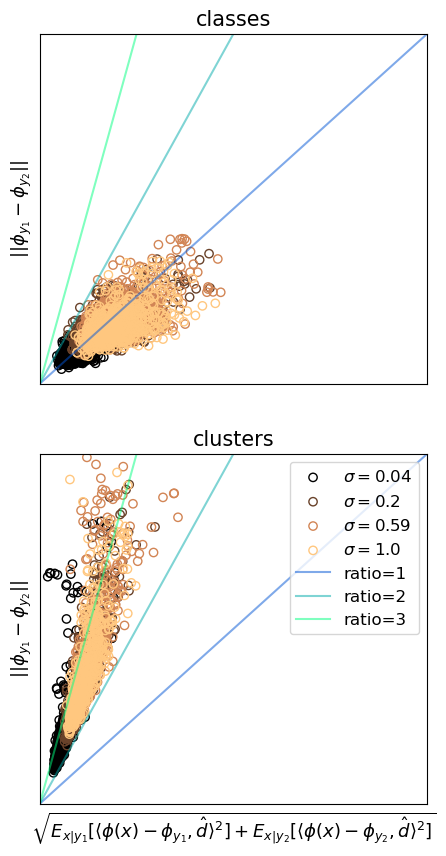

In [157]:
f, axs = plt.subplots(2,1, figsize = (5,10), sharex=True, sharey=True)
colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors_copper = [colormap(i) for i in np.linspace(0, 1,len(sigmas))]

colormap = plt.cm.winter #nipy_spectral, Set1,Paired   
plot_colors_spectral = [colormap(i) for i in np.linspace(0, 1,4 )][1::]

for i in range(len(sigmas)):
    sig = sigmas[i]
    axs[0].scatter(all_vars_classes[sig] ,all_diffs_classes[sig],  alpha = 1, facecolors='none',color=plot_colors_copper[i]);
axs[0].set_ylabel(r'$||\phi_{y_1} - \phi_{y_2 }||$', fontsize=13)
for r in range(3):
    axs[0].plot([0,2],[0,2**(r+1)], color=plot_colors_spectral[r],label = 'ratio='+str(r+1) , alpha = .5)

axs[0].set_title('classes', fontsize=15)
axs[0].set_xlim(0,.2)
axs[0].set_ylim(0,.2)

## clusters 
for i in range(len(sigmas)):
    sig = sigmas[i]
    axs[1].scatter(all_vars_clusters[sig] ,all_diffs_clusters[sig],  alpha = 1, color=plot_colors_copper[i] 
                   ,facecolors='none', label = f"$\sigma=${round(sig/255,2)}" );
axs[1].set_ylabel(r'$||\phi_{y_1} - \phi_{y_2}||$', fontsize=13)
axs[1].set_xlabel(r'$ \sqrt{E_{x|y_1} [ \langle \phi(x) - \phi_{y_1} , \hat{d} \rangle ^2 ] + E_{x|y_2} [ \langle \phi(x) - \phi_{y_2}, \hat{d} \rangle^2 ]}$' ,  fontsize=13)
for r in range(3):
    axs[1].plot([0,2],[0,2**(r+1)], color=plot_colors_spectral[r],label = 'ratio='+str(r+1) , alpha = .5)


axs[1].set_title('clusters', fontsize=15)
axs[0].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)
axs[1].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)
axs[1].set_xlim(0,.2)
axs[1].set_ylim(0,.2)
# axs[0].legend(loc="upper right", fontsize=12)
axs[1].legend(loc="upper right", fontsize=12);

# plt.savefig(results_dir + 'embedding_dprime_scatter.pdf',bbox_inches='tight')    


### example of some clusters (test set )


In [173]:
myids = random.sample(range(n_clusters), 10)
myids

[988, 738, 945, 912, 734, 771, 298, 543, 440, 254]

tensor(67)


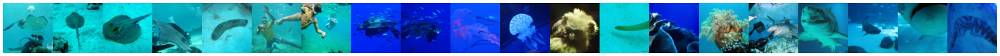

tensor(43)


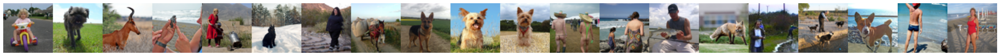

tensor(98)


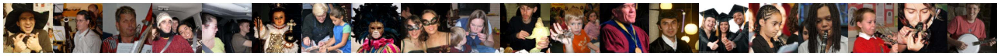

tensor(58)


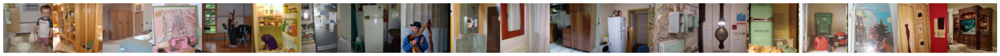

tensor(36)


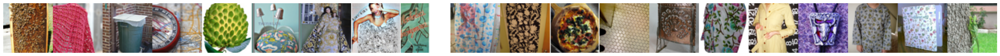

tensor(35)


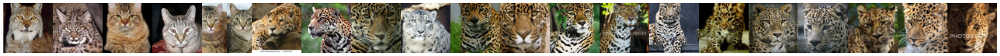

tensor(114)


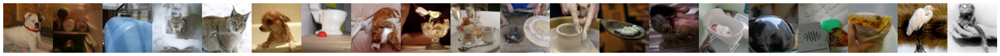

tensor(127)


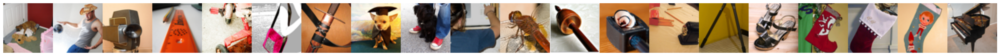

tensor(68)


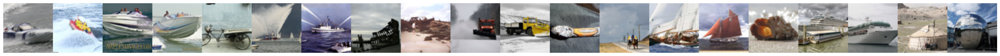

tensor(72)


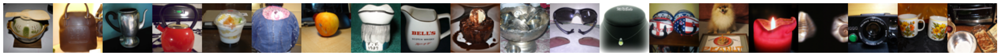

In [174]:
sig = 50
for c in  myids:
    labels = torch.tensor(kmeans_results[sig][n_clusters].labels_)    
    print((labels == c).sum())
    show_im_grid(test_sets_cat[labels == c][0:20], n_columns= 20)

## t-SNE

### local distances are preserved. Global distances are not so meaningful

7.805257320404053


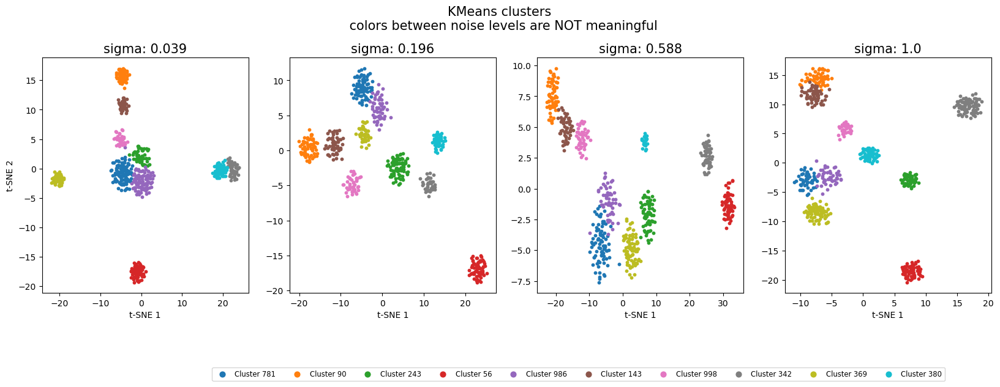

In [608]:
start_time = time.time()
random_labels = random.sample(range(n_clusters), 10)

f, axs = plt.subplots(1,4, figsize=(5 * 4, 5))
f.suptitle('KMeans clusters \n colors between noise levels are NOT meaningful', fontsize = 15,  y=1.05)
# plt.tight_layout()
sigmas = list(phis.keys())
sigmas.reverse()

### loop over sigmas 
for i in range(len(sigmas)):
    sig = sigmas[i]
    cluster_labels = torch.tensor(kmeans_results[sig][n_clusters].labels_)  #50k 

    ## make a subset of data from random clusters 
    temp = []
    class_counts = []
    for label in random_labels:
        temp.append(torch.cat(phis[sig])[cluster_labels == label].cpu())    
        class_counts.append(temp[-1].shape[0]) # save the size of the cluster 
    phis_in = torch.vstack(temp)
    
    ### compute tSNE
    tsne = TSNE(n_components=2, perplexity=int(sum(class_counts)/len(class_counts)), random_state=41, max_iter=10000)
    data_tsne = tsne.fit_transform(phis_in)
    # print(tsne.n_iter_)
    # print(tsne.learning_rate_)
    
    # print(data_tsne.shape)

    ### plot with different colors 
    counter = 0
    for j in range(len(temp)):
        axs[i].scatter(data_tsne[counter:counter+class_counts[j], 0], data_tsne[counter:counter+class_counts[j], 1], 
                       s=10, label=f"Cluster {random_labels[j]}", alpha=1 )
        counter += class_counts[j]
    axs[i].set_xlabel('t-SNE 1')
    axs[i].set_title(f'sigma: {round(sig/255, 3)}', fontsize = 15)
    
axs[0].set_ylabel('t-SNE 2')
axs[i].legend(
    loc='upper center',
    bbox_to_anchor=(-1, -0.3),
    ncol=len(unique_labels),  
    fontsize='small',
    markerscale=2
)
print(time.time() - start_time)

4.206529855728149


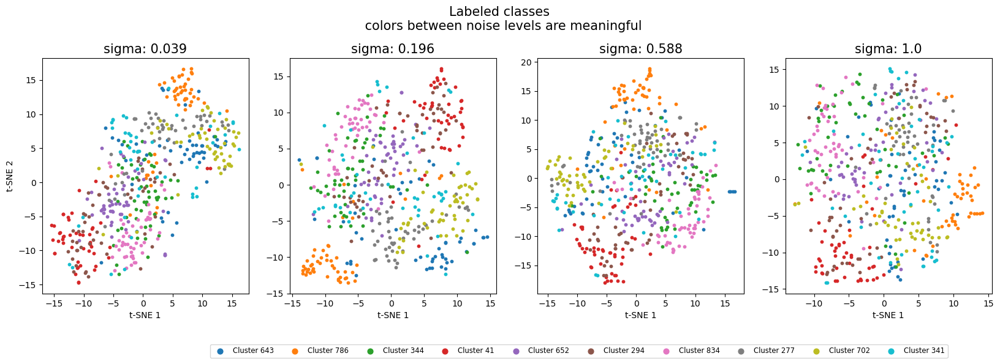

In [605]:
class_labels = torch.cat([torch.ones(test_sets[c].shape[0])* c for c in range(len(test_sets))])

start_time = time.time()


f, axs = plt.subplots(1,4, figsize=(5 * 4, 5))
f.suptitle('Labeled classes \n colors between noise levels are meaningful', fontsize = 15,  y=1.05)


### loop over sigmas 
for i in range(len(sigmas)):
    sig = sigmas[i]
    
    ## make a subset of data from random clusters (same id for all noise levels) 
    phis_in = torch.cat([phis[sig][label] for label in random_labels]).cpu().numpy()
    class_counts = [phis[sig][label].shape[0] for label in random_labels]

    ### compute tSNE    
    tsne = TSNE(n_components=2, perplexity=50, random_state=41, max_iter=10000)    
    data_tsne = tsne.fit_transform(phis_in)
    
    # print(tsne.n_iter_)
    # print(tsne.learning_rate_)
        

    ### plot with different colors     
    counter = 0
    for j in range(len(class_counts)):
        axs[i].scatter(data_tsne[counter:counter+class_counts[j], 0], data_tsne[counter:counter+class_counts[j], 1], 
                       s=10, label=f"Cluster {random_labels[j]}", alpha=1)
        counter += class_counts[j]
    axs[i].set_xlabel('t-SNE 1')
    axs[i].set_title(f'sigma: {round(sig/255, 3)}', fontsize = 15)
    axs[i].set_xlabel('t-SNE 1')
axs[0].set_ylabel('t-SNE 2')
axs[-1].legend(
    loc='upper center',
    bbox_to_anchor=(-1, -0.2),
    ncol=len(unique_labels), 
    fontsize='small',
    markerscale=2
)
print(time.time() - start_time)


# Union of subspaces: Variance of $\phi$  per channel? 

If variance of $\phi$ is zero at inactive channels $\rightarrow$ cluster is confined to a subspace.




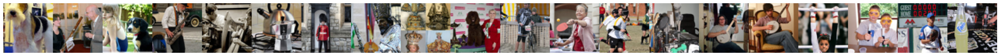

Text(0.5, 1.0, 'cluster: 765')

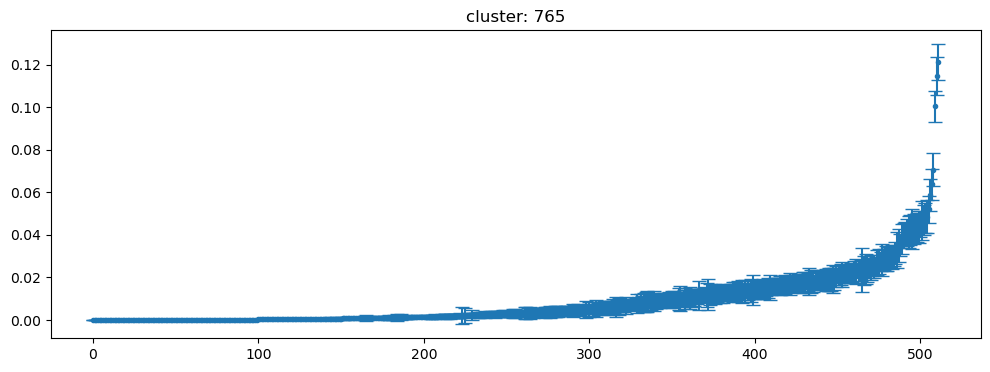

In [177]:
i = torch.randint(low= 0, high = n_clusters, size = (1,)).item()
sig = 150
show_im_grid(test_sets_cat[kmeans_results[sig][n_clusters].labels_ == i][0:20] , n_columns= 20 ) 
myids = torch.cat(phis[group][sig])[kmeans_results[sig][n_clusters].labels_ == i].mean(dim = 0).sort()[1].cpu()
plt.figure(figsize = (12,4))
plt.errorbar( range(512),  torch.cat(phis[group][sig])[kmeans_results[sig][n_clusters].labels_ == 0].mean(dim = 0).sort()[0].cpu(), 
             yerr= torch.cat(phis[group][sig])[kmeans_results[sig][n_clusters].labels_ == i].std(dim = 0)[myids].cpu() ,fmt =  '.', capsize = 5)
plt.title(f'cluster: {i}')

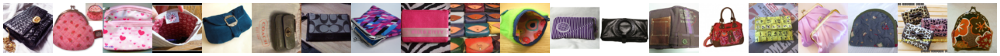

Text(0.5, 1.0, 'class: 344')

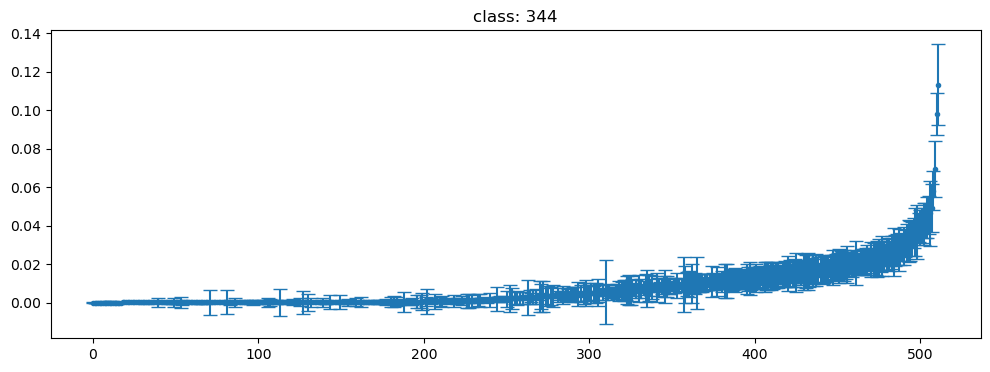

In [67]:
i = torch.randint(low= 0, high = n_clusters, size = (1,)).item()
sig = 150
show_im_grid(test_sets[i][0:20] , n_columns= 20 ) 
plt.figure(figsize = (12,4))
plt.errorbar( range(512),  phis[group][sig][i].mean(dim = 0).sort()[0].cpu(), 
             yerr= phis[group][sig][i].std(dim = 0)[myids].cpu() ,fmt =  '.', capsize = 5)
plt.title(f'class: {i}')

#### make it better: instead of finding clusters and then checking to see if they lie on subspaces, we can directly find the subspaces and then see how data is distributed on them

# Symmetrized KL divergence between $p(x|x^c_1)$ and $p(x|x^c_2)$

In [59]:
sig = 150
my_ims_phi = phi_c_noise_averaged(denoisers[group], 
                     x_c= my_ims.to(device) , 
                     sigs= (sig/255) * torch.ones(my_ims.shape[0],1,1,1).to(device), 
                     n_noise=1)[3]

In [60]:
sims = similarity_matrix(my_ims_phi)



In [172]:
sims[20].sort(descending = True)[1].cpu()[[0,-1]]

tensor([20, 81])

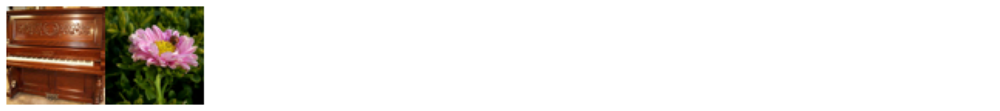

In [199]:
#9
x = my_ims[sims[12].sort(descending = True)[1].cpu()[[0,-6]]].to(device)
show_im_grid(x)

In [222]:
n = len(x)
denoised_xs_cond=[]
sig = 255
# sub_ids = torch.tensor([3,19, 22, 5,13, 44, 45, 49, 89,92, 52, 53, 62,81, 86,97 , 116])
# ids_inp = torch.randint(0,len(my_ids), (n,))

# x = my_ims[[torch.randperm(len(my_ids))[0:n]] ].to(device)

noise =  torch.randn_like(x).to(device)

# sigs = (sig/255) * torch.ones(x.shape[0],1,1,1).to(device)

# phi_x = phi_c_noise_averaged(denoisers[group], x_c=x, sigs=sigs, n_noise=50) 


x_inp = x + sig/255 * noise
# x_inp = .5  +  sig/255 * noise

denoised = denoisers[group](x_inp).detach()

# # get the conditional score 
for i in range(len(x)):
    im = x[i:i+1]
    phi_xc = phi_c_noise_averaged(denoisers[group], x_c= im , sigs= (sig/255) * torch.ones(1,1,1,1).to(device), n_noise=50) 
    phi_xc = repeat_phi(phi_xc, x.shape[0])
    x_matched,_ = match_phis_mid_block(denoisers[group], x_noisy=x+ sig/255 *noise,target_phi = phi_xc )
    denoised_matched_incorrect = denoisers[group](x_matched).detach()
    denoised_xs_cond.append(denoised_matched_incorrect)

    
# print(peak_signal_noise_ratio(x.cpu().numpy(), denoised.cpu().numpy()), 
#   peak_signal_noise_ratio(x.cpu().numpy(), denoised_matched_correct.cpu().numpy()),
#   peak_signal_noise_ratio(x.cpu().numpy(), denoised_matched_incorrect.cpu().numpy()))    

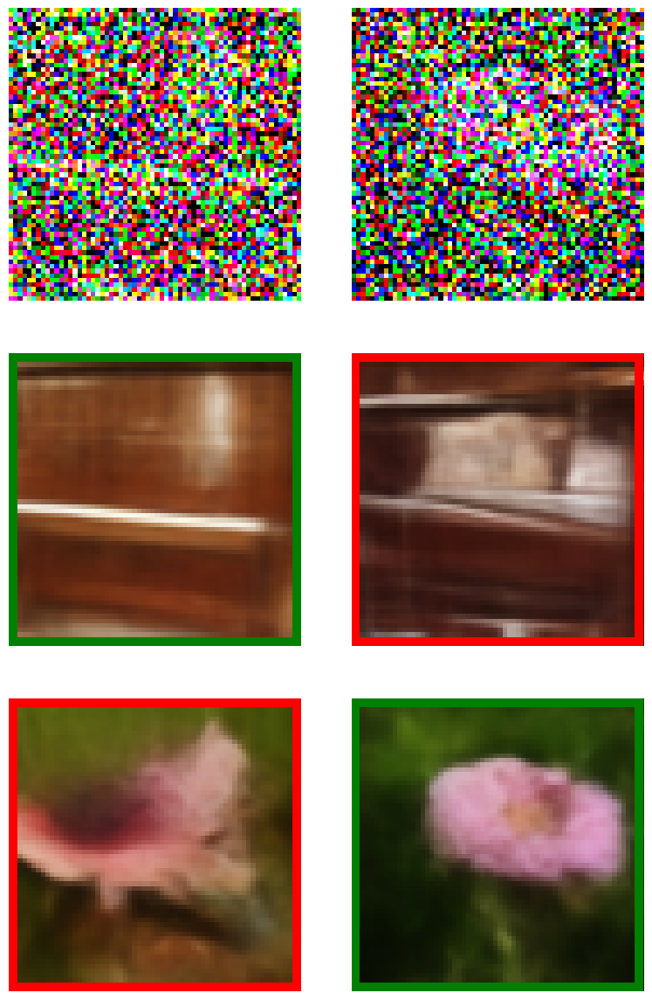

In [223]:
### plot


f , axs = plt.subplots(n+1 ,n, figsize = (4*(n), 4*(n+1))   )
plt.tight_layout()

axs[0,0].set_axis_off()
axs[-1,0].set_axis_off()

for j in range(n):
    fig = axs[0,j].imshow(torch.clip(x_inp[j], 0,1).detach().permute(1,2,0).cpu())
    # fig = axs[i+1,0].imshow(torch.clip(x_inp[i], 0,1).detach().permute(1,2,0).cpu(), 'gray', vmin=0, vmax = 1)
    
    axs[0,j].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)
    # pa = patches.Rectangle((0,0), width=x.shape[2]-1, height=x.shape[2]-1, angle=0.0, edgecolor = 'g', lw=10, fill=None)
    # axs[0,j+1].add_patch(pa) 
    axs[0,j].set_axis_off()    

# for i in range(n): 
    # fig = axs[i+1,0].imshow(x[i].permute(1,2,0).cpu(), vmin=0, vmax = 1)
    # fig = axs[0,j+1].imshow(, 'gray')    
    # axs[i+1,0].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)    
    
for i in range(n):
    for j in range(n ):         
        fig = axs[i+1,j].imshow(torch.clip(denoised_xs_cond[i][j],0,1).permute(1,2,0).cpu(), 'gray')
        axs[i+1,j].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)
        if i==j:
            pa = patches.Rectangle((0,0), width=x.shape[2]-1, height=x.shape[2]-1, angle=0.0, edgecolor = 'g', lw=10, fill=None)
            axs[i+1,j].add_patch(pa) 
            axs[i+1,j].set_axis_off()
        else:
            pa = patches.Rectangle((0,0), width=x.shape[2]-1, height=x.shape[2]-1, angle=0.0, edgecolor = 'r', lw=10, fill=None)
            axs[i+1,j].add_patch(pa) 
            axs[i+1,j].set_axis_off()
            
            # axs[-1,i+1].imshow(torch.clip(denoised[i],0,1).permute(1,2,0).cpu() )
            # pa = patches.Rectangle((0,0), width=x.shape[2]-1, height=x.shape[2]-1, angle=0.0, edgecolor = 'orange', lw=10, fill=None)
            # axs[-1,i+1].add_patch(pa) 
            # axs[-1,i+1].set_axis_off()            

    axs[i+1,-1].set_axis_off()

plt.savefig( '../results/matching_effect_noise_init_ex_' + str(int(sig))+'_2.png',bbox_inches='tight', dpi = 30) ;   


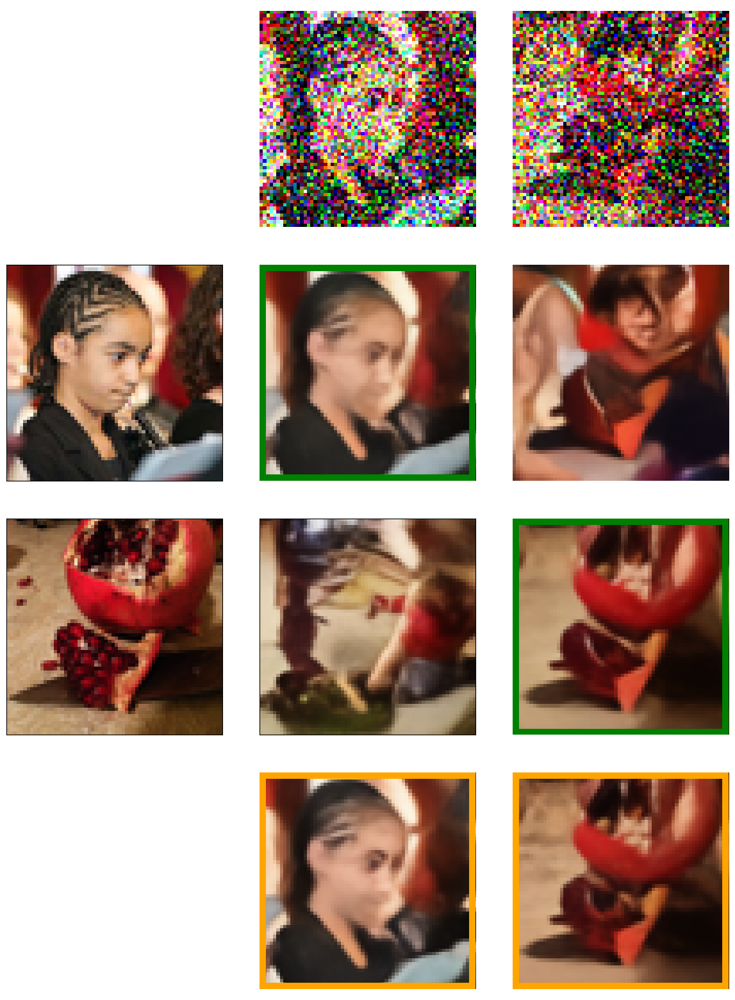

In [165]:
### plot


f , axs = plt.subplots(n+2 ,n+1, figsize = (4*(n+1), 4*(n+2))   )
plt.tight_layout()

axs[0,0].set_axis_off()
axs[-1,0].set_axis_off()

for j in range(n):
    fig = axs[0,j+1].imshow(torch.clip(x_inp[j], 0,1).detach().permute(1,2,0).cpu())
    # fig = axs[i+1,0].imshow(torch.clip(x_inp[i], 0,1).detach().permute(1,2,0).cpu(), 'gray', vmin=0, vmax = 1)
    
    axs[0,j+1].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)
    # pa = patches.Rectangle((0,0), width=x.shape[2]-1, height=x.shape[2]-1, angle=0.0, edgecolor = 'g', lw=10, fill=None)
    # axs[0,j+1].add_patch(pa) 
    axs[0,j+1].set_axis_off()    

for i in range(n): 
    fig = axs[i+1,0].imshow(x[i].permute(1,2,0).cpu(), vmin=0, vmax = 1)
    # fig = axs[0,j+1].imshow(, 'gray')    
    axs[i+1,0].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)    
    
for i in range(n):
    for j in range(n ):         
        fig = axs[i+1,j+1].imshow(torch.clip(denoised_xs_cond[i][j],0,1).permute(1,2,0).cpu(), 'gray')
        axs[i+1,j+1].tick_params(bottom=False,left=False,labelleft=False,labelbottom=False)
        if i==j:
            pa = patches.Rectangle((0,0), width=x.shape[2]-1, height=x.shape[2]-1, angle=0.0, edgecolor = 'g', lw=10, fill=None)
            axs[i+1,j+1].add_patch(pa) 
            axs[i+1,j+1].set_axis_off()
            axs[-1,i+1].imshow(torch.clip(denoised[i],0,1).permute(1,2,0).cpu() )
            pa = patches.Rectangle((0,0), width=x.shape[2]-1, height=x.shape[2]-1, angle=0.0, edgecolor = 'orange', lw=10, fill=None)
            axs[-1,i+1].add_patch(pa) 
            axs[-1,i+1].set_axis_off()            

    axs[i+1,-1].set_axis_off()

# plt.savefig( '../results/matching_effect_noise_init_ex_' + str(int(sig))+'2.pdf',bbox_inches='tight') ;   


In [15]:
def get_scores_diff(x, x_c, denoiser, sig, device,n_noise, n_x ): 
    
    sigs = (sig) * torch.ones(x.shape[0],1,1,1).to(device)

    # get the score after matching     
    phi_x = phi_c_noise_averaged(denoiser, x_c=x, sigs=sigs, n_noise=50) # get centeroid phi over noise realizations 
    phi_x = repeat_phi(phi_x, n_x)
    
    phi_xc = phi_c_noise_averaged(denoiser, x_c=x_c, sigs=sigs, n_noise=50) # get centeroid phi over noise realizations 
    phi_xc = repeat_phi(phi_xc, n_x)

    x = torch.tile(x, (n_x, 1,1,1))
    noise = torch.randn_like(x)
    
    x_matched_correct,_ = match_phis_mid_block(denoiser, x_noisy=x + sig *noise, target_phi = phi_x , max_iter=100)
    x_matched_incorrect,_ = match_phis_mid_block(denoiser, x_noisy=x + sig *noise, target_phi = phi_xc , max_iter=100)
    
    with torch.no_grad():
        score_matched_correct = x+ noise - denoiser(x_matched_correct).detach()
        score_matched_incorrect = x+ noise - denoiser(x_matched_incorrect).detach()
    norms = (torch.norm((score_matched_correct - score_matched_incorrect), dim=(2,3)).norm(dim = 1) )**2
    expectation = norms.mean(0)
    return expectation


    
def integrate_diffs(x1, x2, denoiser, sigma_range, device,n_noise, n_x): 
    dist = 0
    for sig in sigma_range: 
        print(f'sigma: {sig}' )
        expect1 = get_scores_diff(x=x1, x_c=x2, denoiser=denoiser, sig=sig, device=device, n_noise=n_noise, n_x=n_x )
        expect2 = get_scores_diff(x=x2, x_c=x1, denoiser=denoiser, sig=sig, device=device, n_noise=n_noise, n_x=n_x )
        
        dist += (expect1 + expect2)
        
    return dist/len(sigma_range)


In [73]:
ids1 = np.random.randint(low=0, high= test_sets_cat.shape[0], size = 100)
ids2 = np.random.randint(low=0, high= test_sets_cat.shape[0], size = 100)

density_dists = {}
counter = 0
for id1, id2 in zip(ids1, ids2):
    print(counter , '------- id1=', id1, ', id2=', id2)    
    start_time = time.time()    
    out = integrate_diffs(x1=test_sets_cat[id1:id1+1].to(device), 
                          x2=test_sets_cat[id2:id2+1].to(device), 
                          denoiser=denoisers[group], 
                          sigma_range=torch.linspace(0,1,11), 
                          device = device , 
                          n_noise=50, 
                          n_x=50 )
    
    
    density_dists[(id1,id2)] = out.item()
    print(f'time for one pair: {time.time() - start_time}')
    counter += 1


 


0 ------- id1= 40480 , id2= 28031
sigma: 0.0
sigma: 0.10000000149011612
sigma: 0.20000000298023224
sigma: 0.30000001192092896
sigma: 0.4000000059604645
sigma: 0.5
sigma: 0.6000000238418579
sigma: 0.699999988079071
sigma: 0.800000011920929
sigma: 0.8999999761581421
sigma: 1.0
time for one pair: 84.50428104400635
1 ------- id1= 41535 , id2= 16008
sigma: 0.0
sigma: 0.10000000149011612
sigma: 0.20000000298023224
sigma: 0.30000001192092896
sigma: 0.4000000059604645
sigma: 0.5
sigma: 0.6000000238418579
sigma: 0.699999988079071
sigma: 0.800000011920929
sigma: 0.8999999761581421
sigma: 1.0
time for one pair: 84.24025893211365
2 ------- id1= 27426 , id2= 46723
sigma: 0.0
sigma: 0.10000000149011612
sigma: 0.20000000298023224
sigma: 0.30000001192092896
sigma: 0.4000000059604645
sigma: 0.5
sigma: 0.6000000238418579
sigma: 0.699999988079071
sigma: 0.800000011920929
sigma: 0.8999999761581421
sigma: 1.0
time for one pair: 84.23884415626526
3 ------- id1= 40025 , id2= 12810
sigma: 0.0
sigma: 0.1000000

In [74]:
embedding_dists = {}
for id1, id2 in zip(ids1, ids2):

    print('------- id1=', id1, ', id2=', id2)   
    
    sig = .5
    sigs = sig * torch.ones(1,1,1,1).to(device)

    # get the score after matching     
    phi_x1 = phi_c_noise_averaged(denoisers[group], x_c=test_sets_cat[id1:id1+1].to(device), sigs=sigs, n_noise=50)[3] # get centeroid phi over noise realizations 
    phi_x2 = phi_c_noise_averaged(denoisers[group], x_c=test_sets_cat[id2:id2+1].to(device), sigs=sigs, n_noise=50)[3] # get centeroid phi over noise realizations 

        
    
    emb_diff = phi_x1 - phi_x2
    
    embedding_dists[(id1,id2)] = ((torch.norm(emb_diff))**2 ).item()


------- id1= 40480 , id2= 28031
------- id1= 41535 , id2= 16008
------- id1= 27426 , id2= 46723
------- id1= 40025 , id2= 12810
------- id1= 14638 , id2= 2917
------- id1= 15014 , id2= 23893
------- id1= 16752 , id2= 44102
------- id1= 25023 , id2= 26965
------- id1= 12956 , id2= 47316
------- id1= 12736 , id2= 7897
------- id1= 47446 , id2= 38161
------- id1= 42358 , id2= 26009
------- id1= 42962 , id2= 19401
------- id1= 46915 , id2= 24960
------- id1= 2869 , id2= 18834
------- id1= 48842 , id2= 1160
------- id1= 20351 , id2= 44157
------- id1= 40928 , id2= 21720
------- id1= 22075 , id2= 39106
------- id1= 31979 , id2= 22777
------- id1= 814 , id2= 30102
------- id1= 4750 , id2= 28553
------- id1= 13792 , id2= 28837
------- id1= 31767 , id2= 42727
------- id1= 30829 , id2= 21675
------- id1= 8683 , id2= 17459
------- id1= 117 , id2= 40963
------- id1= 12473 , id2= 13074
------- id1= 41833 , id2= 28582
------- id1= 24959 , id2= 12024
------- id1= 45991 , id2= 3725
------- id1= 40103 

mixture-color-deep-no-skip


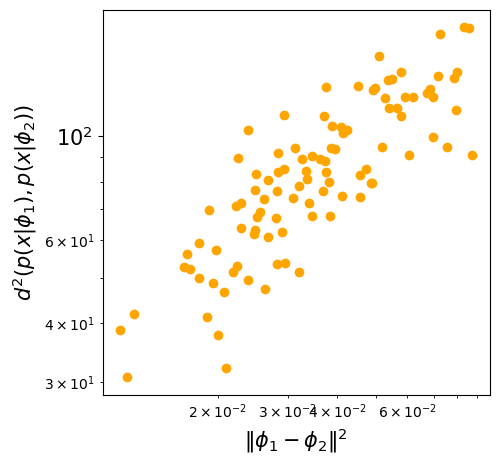

In [75]:
fig, ax1 = plt.subplots(1,1, figsize=(5,5))
embedding_dists_list = []
density_dists_list = []

for k,v in density_dists.items(): 
    embedding_dists_list.append(embedding_dists[k])
    density_dists_list.append(density_dists[k])


ax1.scatter( embedding_dists_list, density_dists_list, color='orange')
# ids_list_lmost = [k for k in embedding_dists if (embedding_dists[k]<.08) & (density_dists[k]<1.5)]
# for i in range(3): 
#     ax1.scatter(embedding_dists[ids_list_lmost[i]], density_dists[ids_list_lmost[i]], color='red')
# ids_list_least = [k for k in embedding_dists if (embedding_dists[k]>.45) & (embedding_dists[k]<1) & (density_dists[k]>20)]
# # ids_list_most = [k for k in embedding_dists if (embedding_dists[k]>.2) & (density_dists[k]>30)]
# for i in range(3): 
#     ax1.scatter(embedding_dists[ids_list_least[i]], density_dists[ids_list_least[i]], color='blue')
    
ax1.set_yscale('log')
ax1.set_xscale('log')
# ax1.set_xlim(0,1)
ax1.set_xlabel('$\Vert \phi_1 - \phi_2\Vert ^2$',fontsize=15)
ax1.set_ylabel(r'$d^2 ( p (x| \phi_1) , p( x|\phi_2) )$',fontsize=15)
# ax1.grid()
ax1.tick_params(axis='both', which='major', labelsize=15)
# plt.savefig(results_dir + 'Euclidean_embedding'+str(len(density_dists))+'.pdf',bbox_inches='tight')    

print(group)

mixture-color-deep-no-skip


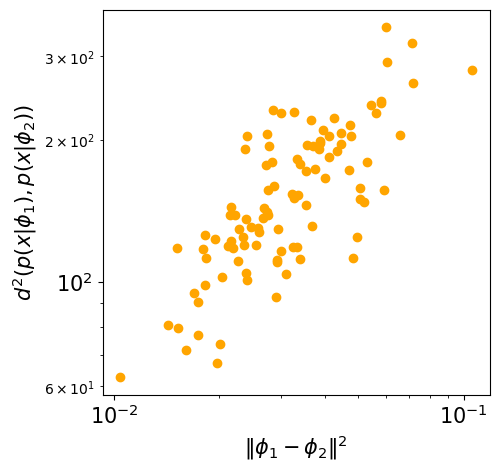

In [530]:
fig, ax1 = plt.subplots(1,1, figsize=(5,5))
embedding_dists_list = []
density_dists_list = []

for k,v in density_dists.items(): 
    embedding_dists_list.append(embedding_dists[k])
    density_dists_list.append(density_dists[k])


ax1.scatter( embedding_dists_list, density_dists_list, color='orange')
# ids_list_lmost = [k for k in embedding_dists if (embedding_dists[k]<.08) & (density_dists[k]<1.5)]
# for i in range(3): 
#     ax1.scatter(embedding_dists[ids_list_lmost[i]], density_dists[ids_list_lmost[i]], color='red')
# ids_list_least = [k for k in embedding_dists if (embedding_dists[k]>.45) & (embedding_dists[k]<1) & (density_dists[k]>20)]
# # ids_list_most = [k for k in embedding_dists if (embedding_dists[k]>.2) & (density_dists[k]>30)]
# for i in range(3): 
#     ax1.scatter(embedding_dists[ids_list_least[i]], density_dists[ids_list_least[i]], color='blue')
    
ax1.set_yscale('log')
ax1.set_xscale('log')
# ax1.set_xlim(0,1)
ax1.set_xlabel('$\Vert \phi_1 - \phi_2\Vert ^2$',fontsize=15)
ax1.set_ylabel(r'$d^2 ( p (x| \phi_1) , p( x|\phi_2) )$',fontsize=15)
# ax1.grid()
ax1.tick_params(axis='both', which='major', labelsize=15)
# plt.savefig(results_dir + 'Euclidean_embedding'+str(len(density_dists))+'.pdf',bbox_inches='tight')    

print(group)

In [527]:
sorted_dict = dict(sorted(embedding_dists.items(), key=lambda item: item[1]))
top_3 = dict(sorted(embedding_dists.items(), key=lambda item: item[1], reverse=False)[:3])
